In [1]:
import warnings
warnings.filterwarnings("ignore")

import cla.metrics
import numpy as np

print('--- use these metrics to compare and evaluate kernels ---')
cla.metrics.metrics_keys()

Unable to determine R home: [WinError 2] The system cannot find the file specified


rpy2 3.X may not support Windows. ECoL metrics may not be available.
--- use these metrics to compare and evaluate kernels ---


Exception ignored from cffi callback <function _consolewrite_ex at 0x000001FD8D0C91F0>:
Traceback (most recent call last):
  File "C:\Users\eleve\anaconda3\lib\site-packages\rpy2\rinterface_lib\callbacks.py", line 133, in _consolewrite_ex
    s = conversion._cchar_to_str_with_maxlen(buf, n, _CCHAR_ENCODING)
  File "C:\Users\eleve\anaconda3\lib\site-packages\rpy2\rinterface_lib\conversion.py", line 138, in _cchar_to_str_with_maxlen
    s = ffi.string(c, maxlen).decode(encoding)
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xd4 in position 0: invalid continuation byte


['classification.ACC',
 'classification.Kappa',
 'classification.F1_Score',
 'classification.Jaccard',
 'classification.Precision',
 'classification.Recall',
 'classification.McNemar',
 'classification.McNemar.CHI2',
 'classification.CochranQ',
 'classification.CochranQ.T',
 'classification.CrossEntropy',
 'classification.Mean_KLD',
 'classification.Brier',
 'classification.ROC_AUC',
 'classification.PR_AUC',
 'classification.BER',
 'classification.SVM.Margin',
 'correlation.IG',
 'correlation.IG.max',
 'correlation.r',
 'correlation.r2',
 'correlation.r.p',
 'correlation.r.max',
 'correlation.r2.max',
 'correlation.r.p.min',
 'correlation.rho',
 'correlation.rho.p',
 'correlation.rho.max',
 'correlation.rho.p.min',
 'correlation.tau',
 'correlation.tau.p',
 'correlation.tau.max',
 'correlation.tau.p.min',
 'test.ES',
 'test.ES.max',
 'test.student',
 'test.student.min',
 'test.student.min.log10',
 'test.student.T',
 'test.student.T.max',
 'test.ANOVA',
 'test.ANOVA.min',
 'test.ANOVA.

# Kernel Types

Let's try different kernel types.

## Response Pattern

Show how each kernel varies with pairwise-point-distances.

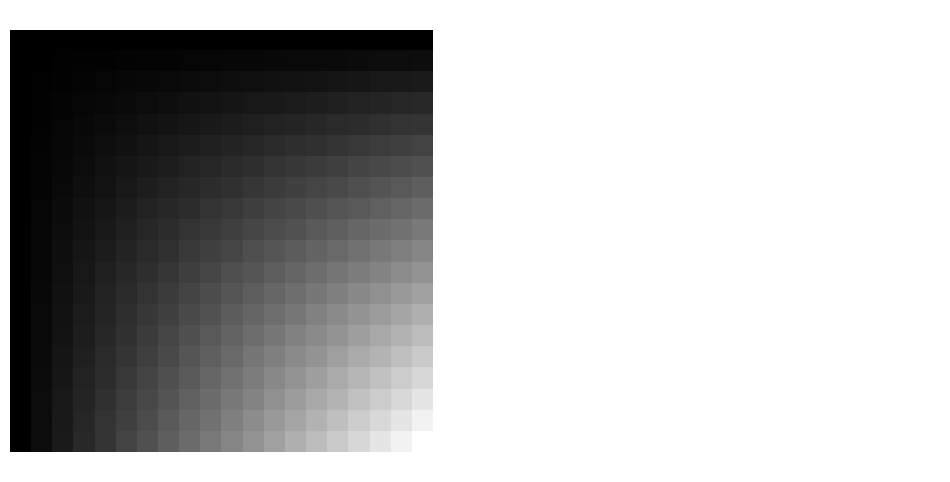

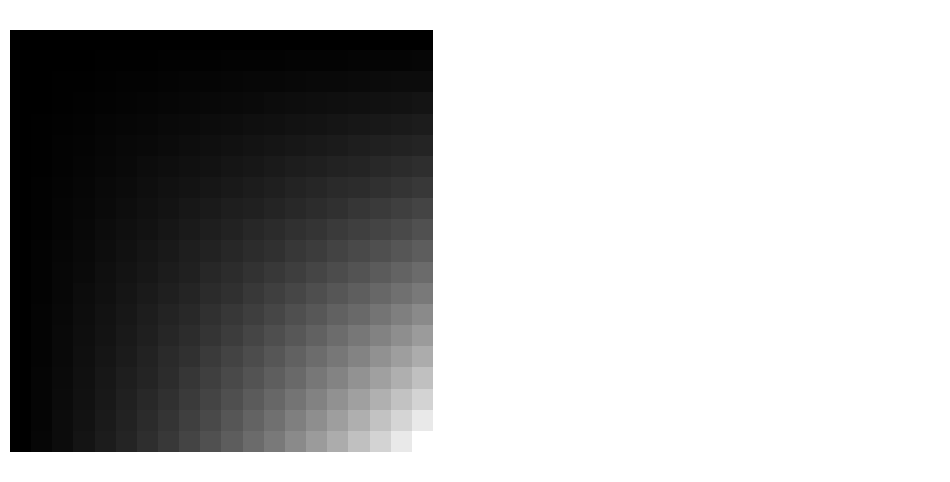

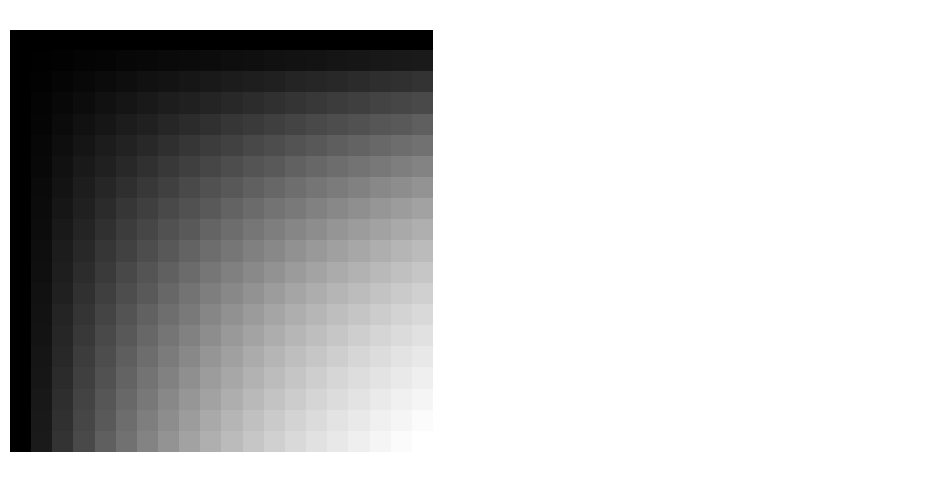

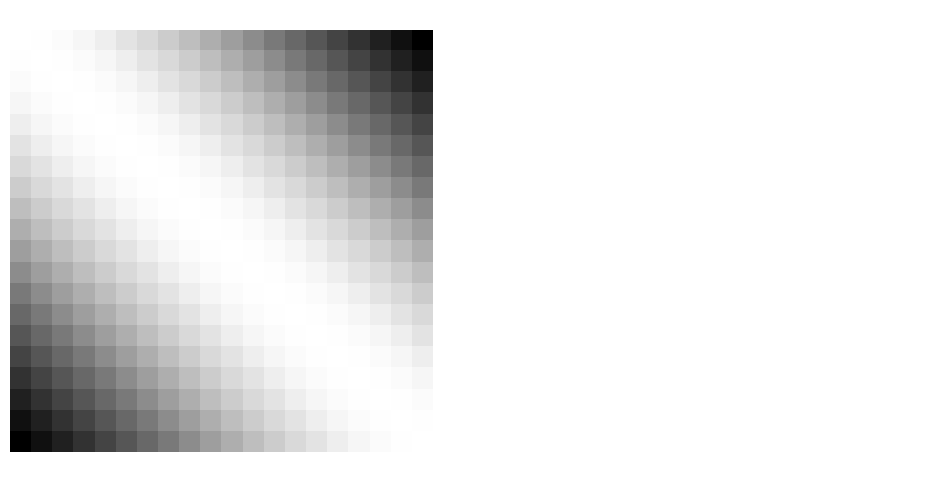

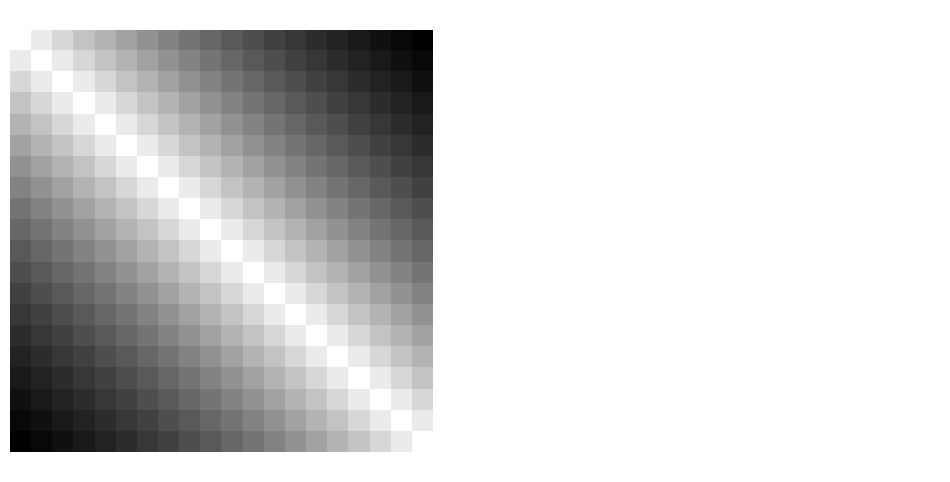

...

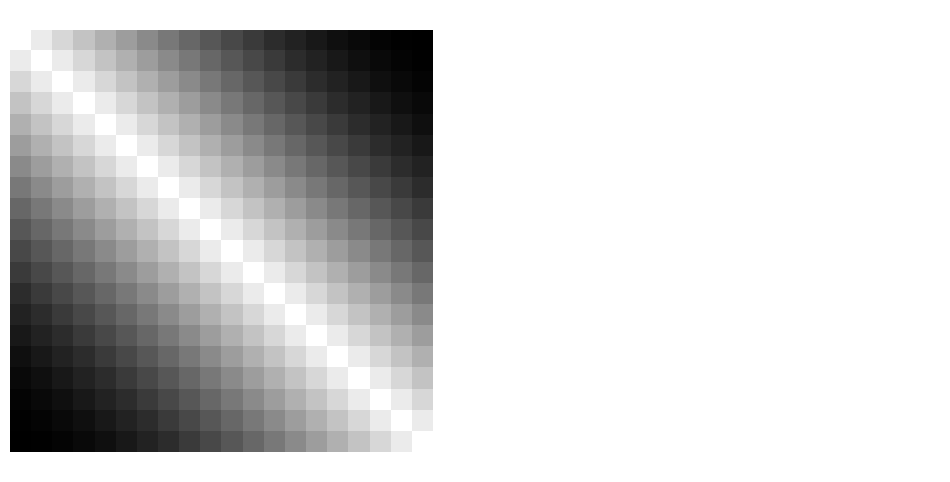

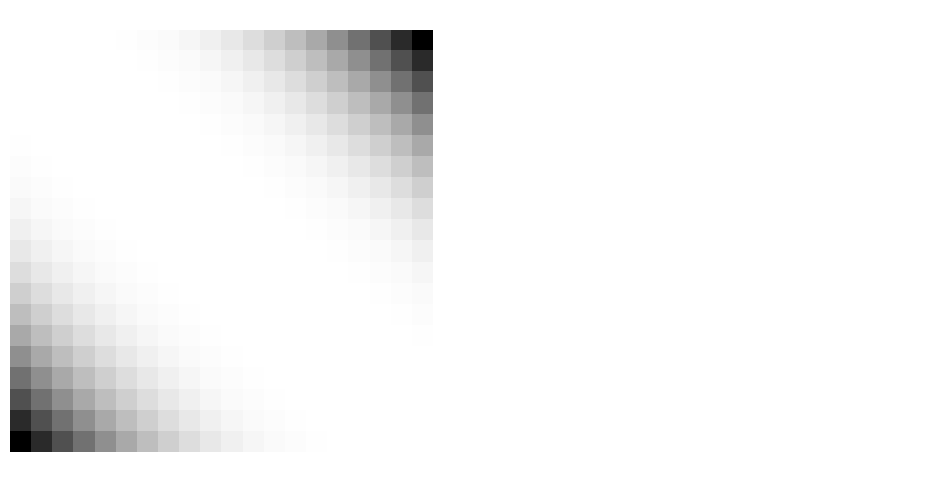

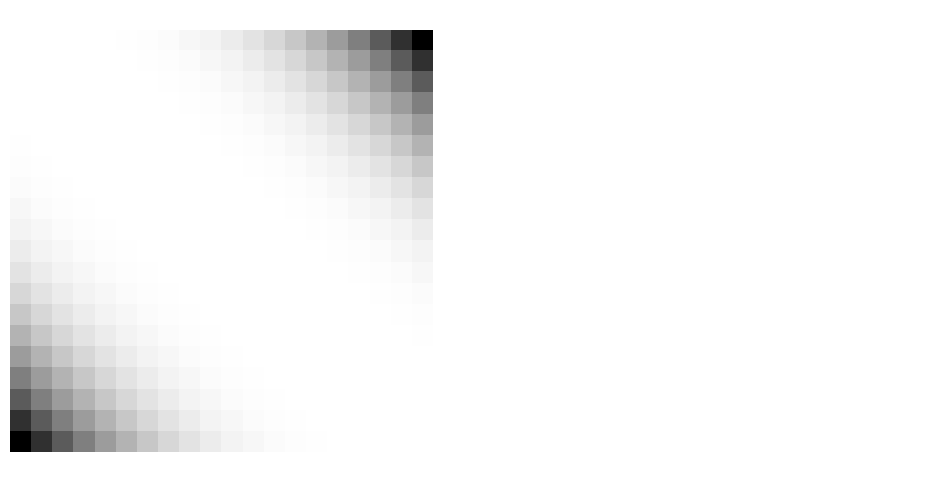

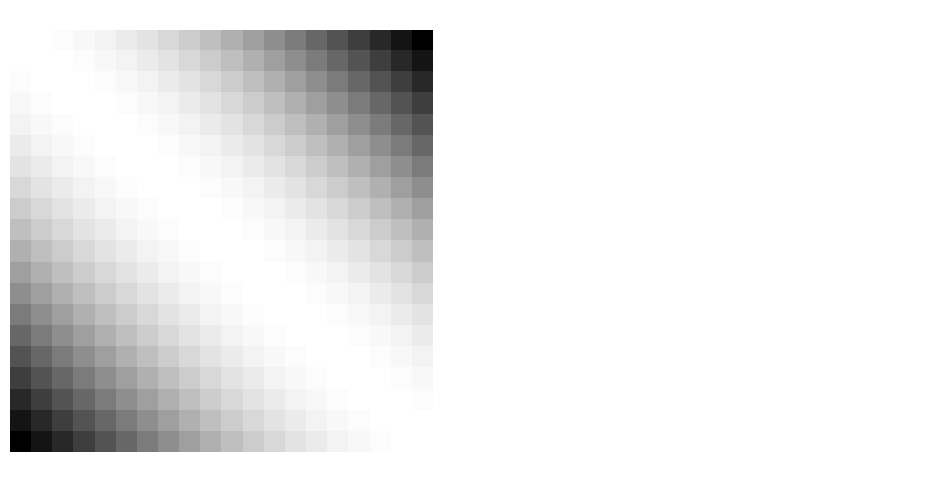

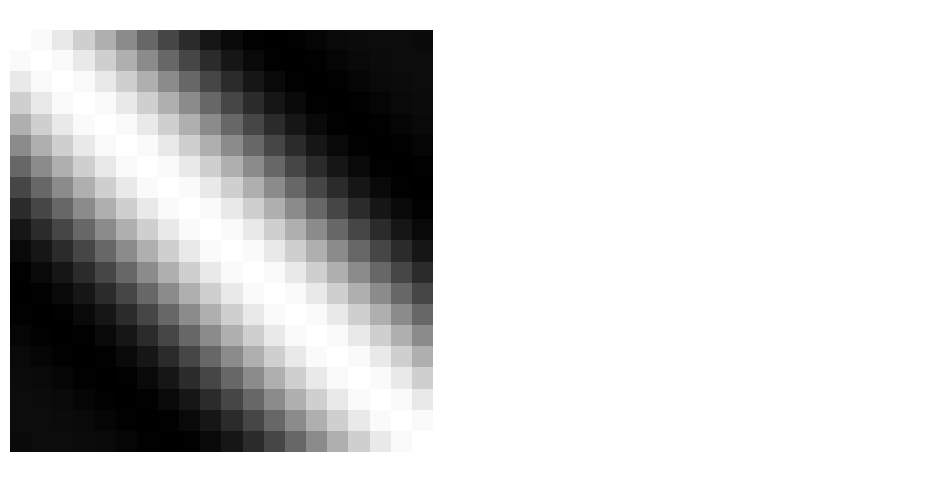

In [2]:
import ackl.metrics

ackl.metrics.linear_response_pattern(20)

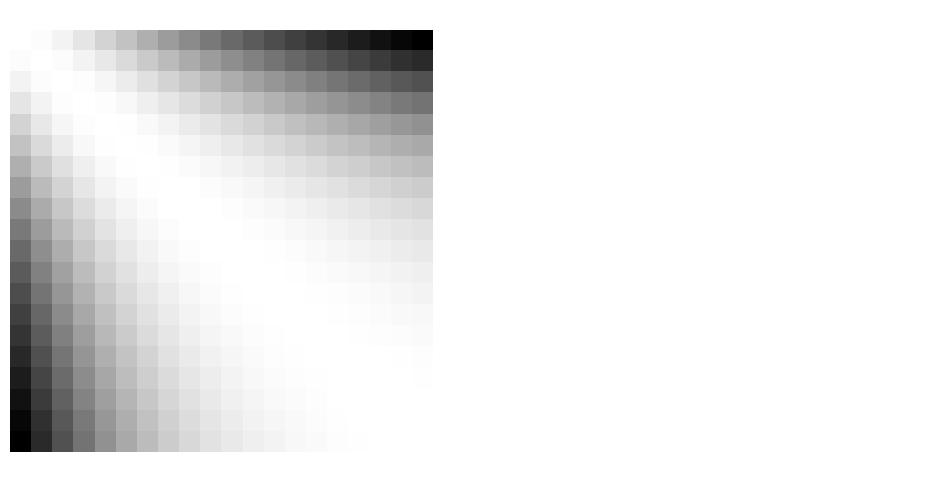

In [3]:
ackl.metrics.cosine_kernel_response_pattern(n = 20, cmap = 'gray', logplot = False, embed_title = False)

## Binary Response Pattern

       0      1 
    0  k(0,0) k(0,1)
    1  k(1,0) k(1,1)

# Real Dataset Experiments

In [4]:
from qsi import io
from sklearn.preprocessing import StandardScaler, MinMaxScaler
import ackl.metrics
import cla.metrics
import pickle
import ackl
from IPython.core.display import HTML, display
import os.path
from sklearn.decomposition import PCA
    
def analyze_dataset(id):
    display(HTML('<h1>' + id + '</h1><hr/><br/>'))
    
    if id == 'salt':
        X, y, X_names, desc, labels = io.load_dataset('salt', x_range = list(range(400,1000)), shift = 200, display=True)
    elif id == 'vintage':
        X, y, X_names, desc, labels = io.load_dataset('vintage_spi', x_range=list(range(3000)), y_subset = [0,3], display=True) 
    else:
        X, y, X_names, desc, labels = io.load_dataset(id)

    _, ms = cla.metrics.get_metrics(X, y)
        
    old_dim = X.shape
    X = PCA(n_components = 0.99).fit_transform(X) # DR to 99% PCA components
    new_dim = X.shape
        
    for pre in ['mm']: # some kernels require non-negative input
        
        pre_desc = ''
    
        if pre == 'mm':
            X = MinMaxScaler().fit_transform(X) 
            pre_desc = 'sklearn.preprocessing.MinMaxScaler'
        elif pre == 'norm':
            X = StandardScaler().fit_transform(X)
            pre_desc = 'sklearn.preprocessing.StandardScaler'
        else:
            pre_desc = 'no preprocessing. use original data.'

        display(HTML('<h2>1. Preprocessing</h2><hr/><p>' + '1.1 PCA: ' + str(old_dim) + ' ==> ' + str(new_dim) + '</p><p>1.2 Feature scaling: ' + pre_desc + '</p><br/>'))
        
        # display(HTML('<h2>2. CLA before kernel' + '</h2><hr/><br/>'))        
        # display(HTML('<p>' + str(ms) + '</p>'))
        
        display(HTML('<h2>2. Try Kernels' + '</h2><hr/><br/>'))
        
        pkl = id + '_' + pre + '_' + ackl.__version__ + '.pkl'
        if True: # not os.path.isfile(pkl): # if pkl already exist, just reload it
        
            dics = ackl.metrics.preview_kernels(X, y,embed_title = False, scale = False, logplot = False)

            # Persist to a local pickle binary file.
            with open(pkl,'wb') as f:
                pickle.dump(dics, f)

        # Load back
        with open (pkl, 'rb') as f:
            dics = pickle.load(f)
        
        display(HTML('<h2>3. Evaluate Metrics' + '</h2><hr/><br/>'))
        html_str = ackl.metrics.visualize_metric_dicts(dics, plot = True)
        display(HTML( html_str ))
        
    display(HTML('<h2>4. Run time' + '</h2><hr/><br/>'))
    dic = ackl.metrics.time_cost_kernels(X, repeat=10)
    print('Averaged run time: ', dic)
        
    display(HTML('<h3>----------- End of Analysis ----------</h3><br/><br/>'))

load dataset from 7545.csv
X.shape (120, 600)  y.shape (120,)


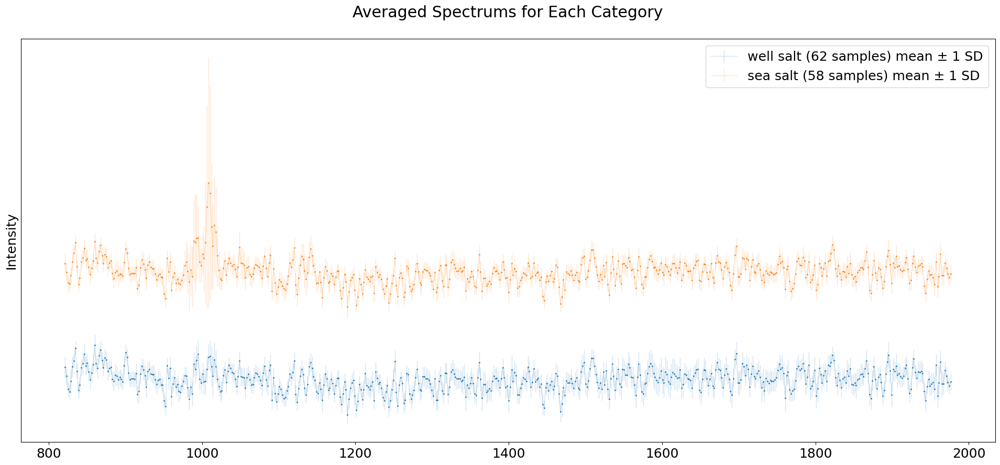

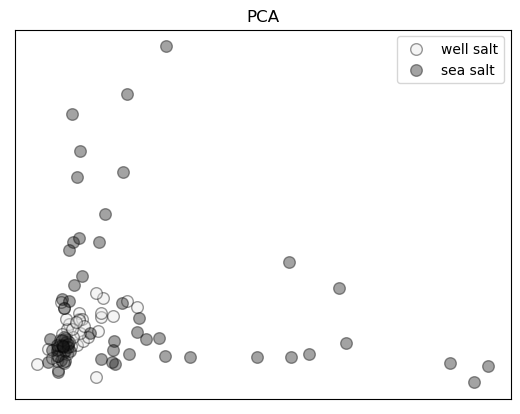

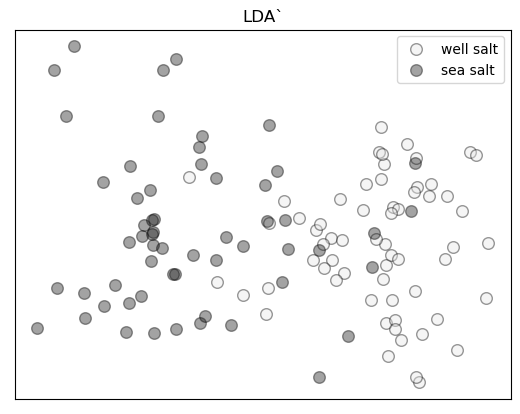

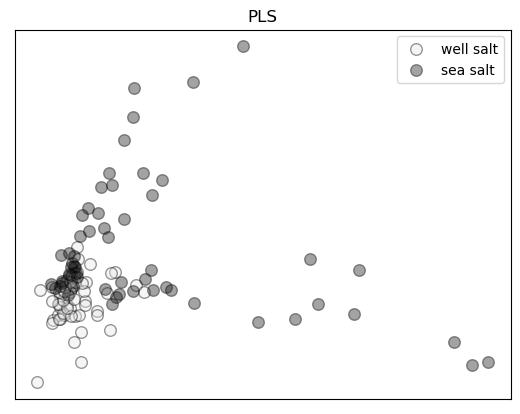

食盐拉曼光谱

C1 - "shenjinkuangyan(zhongyan)：深井矿盐（中盐集团）加碘盐", 
“deep well mineral salt” from CNSIC (China National Salt Industry Co.,Ltd).

C2 - "aozhoutianranhaiyan(huaiyan)：澳洲天然海盐（淮盐）未加碘",
“Australian natural sea salt” from Suyan Group.

DXR2xi显微拉曼成像光谱仪（美国Thermo Fisher公司），
配备有532 nm激光器。
仪器参数设置：
激光功率为10 mw，曝光时间1 s，扫描次数500，
拉曼位移范围为100～3000 cm-1。


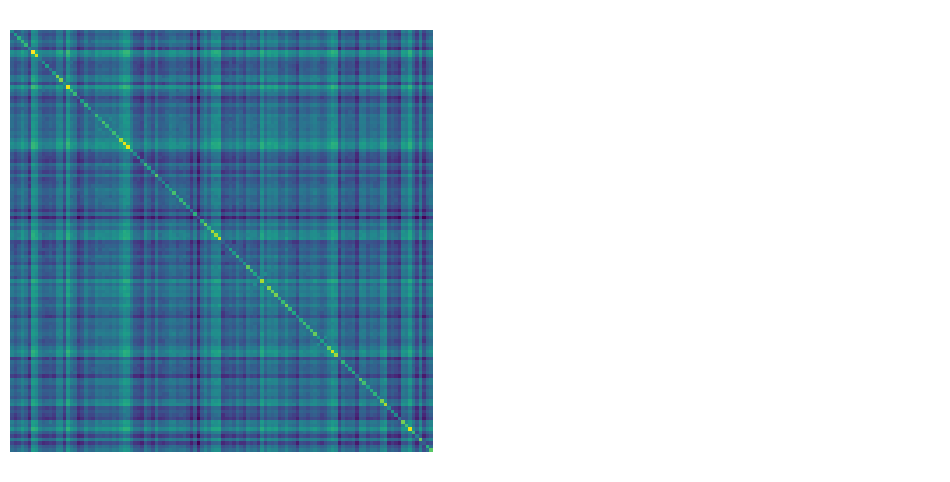

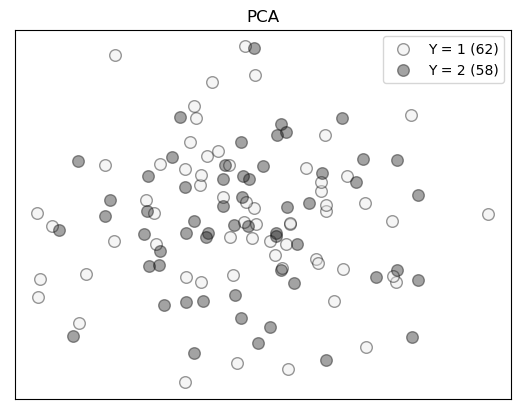

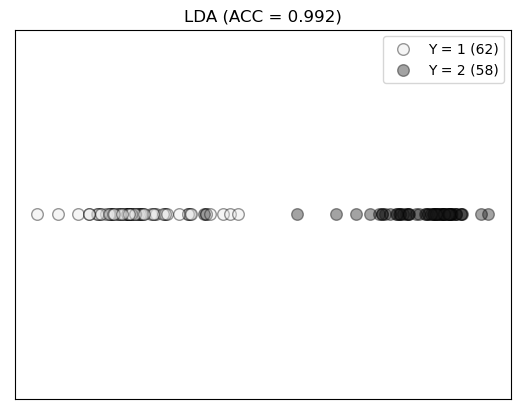

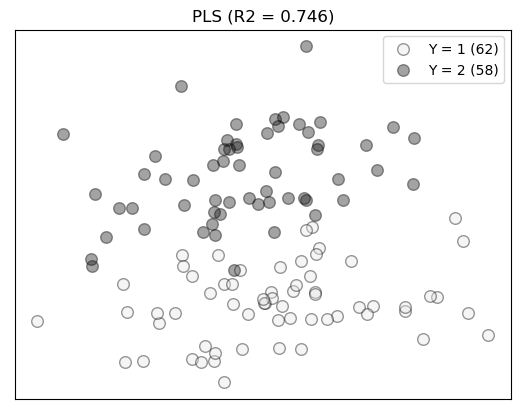

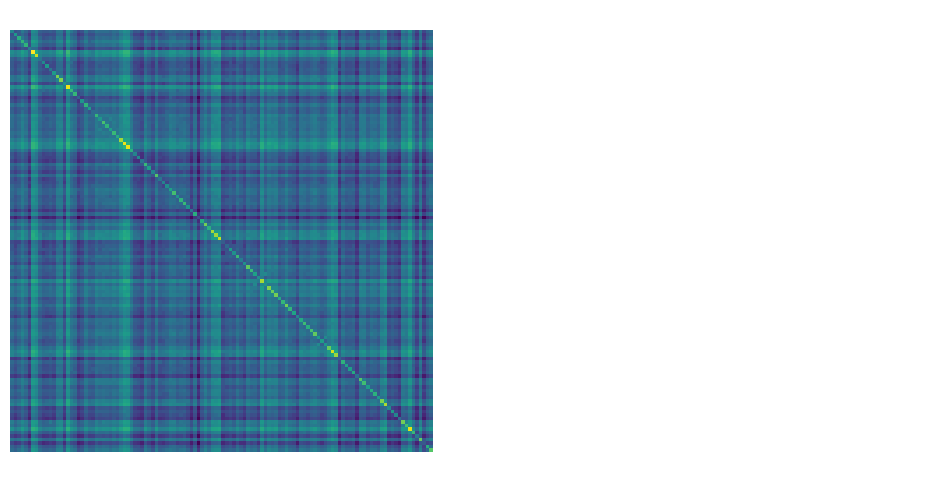

...

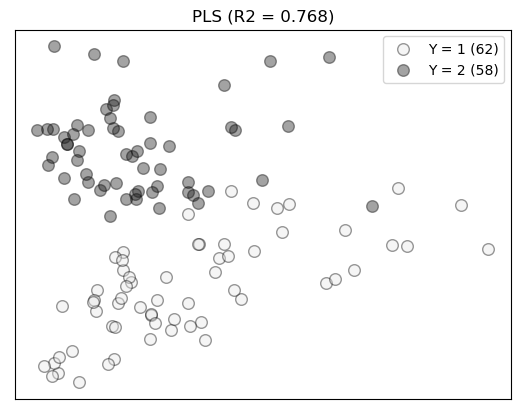

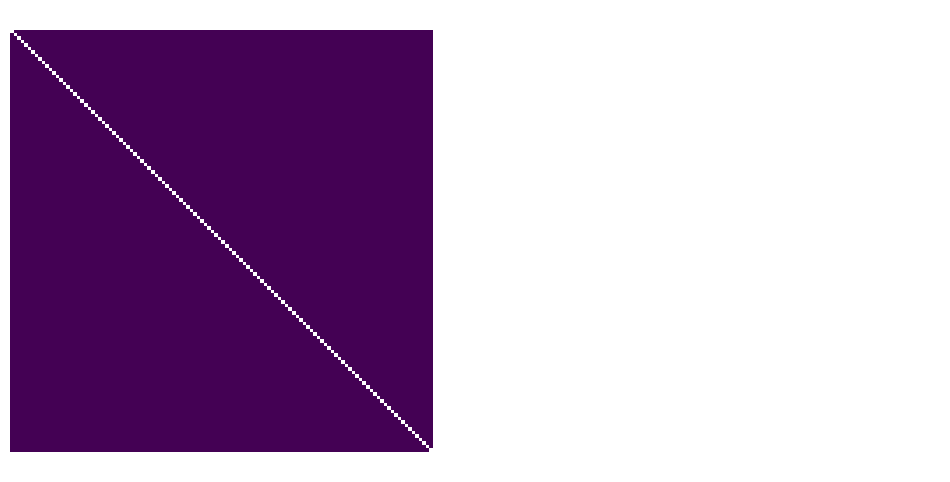

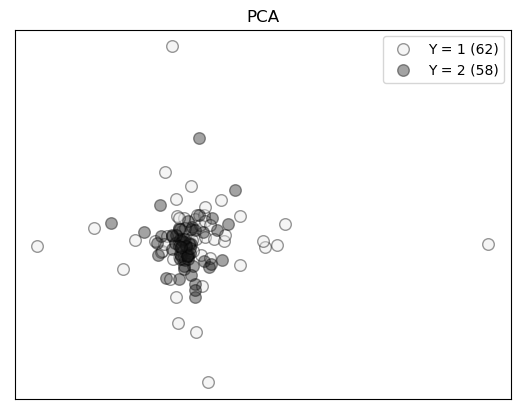

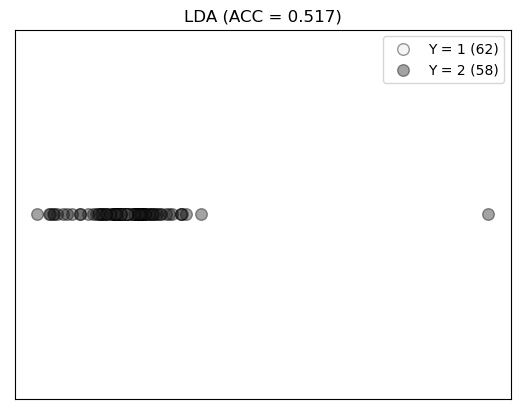

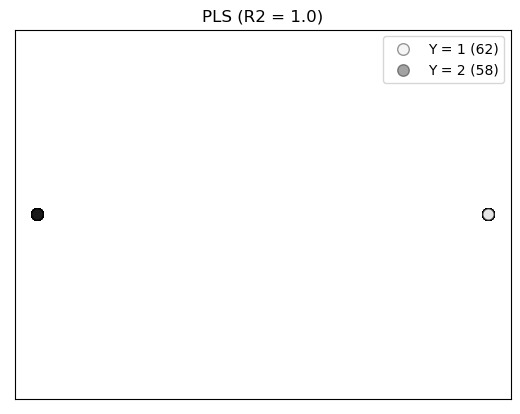

MedianTest Exception:  All values are below the grand median (1.0).


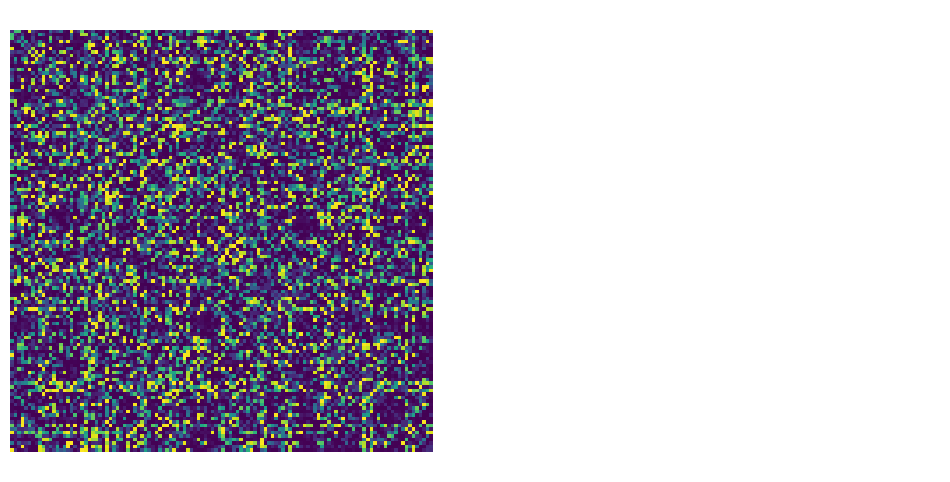

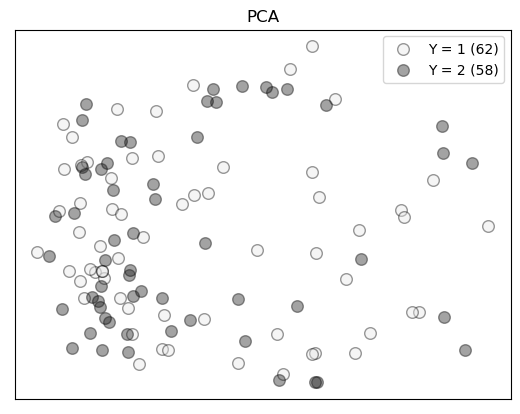

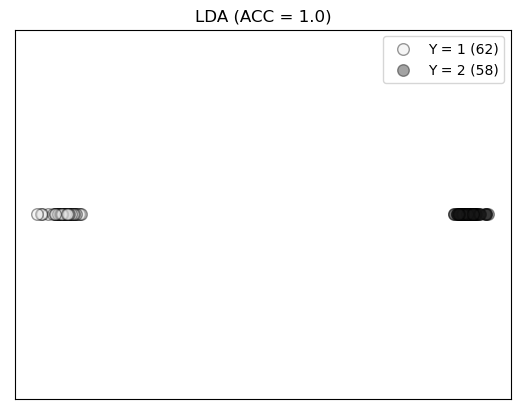

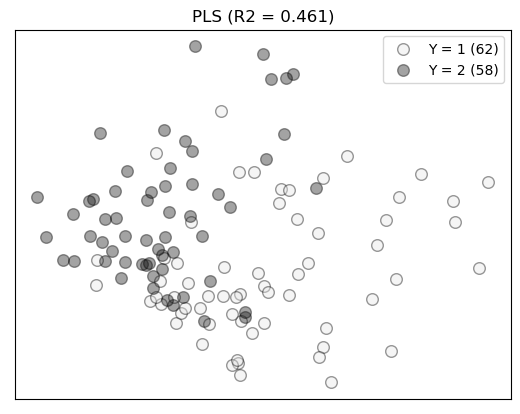

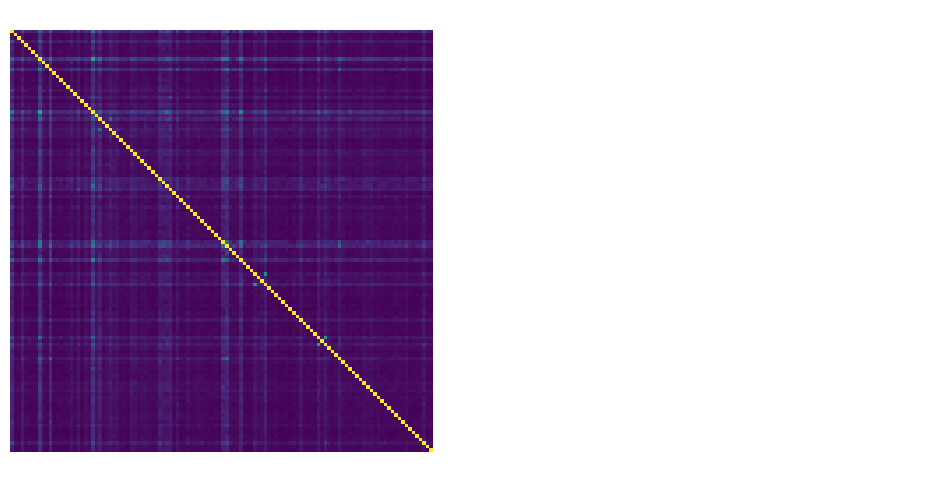

...

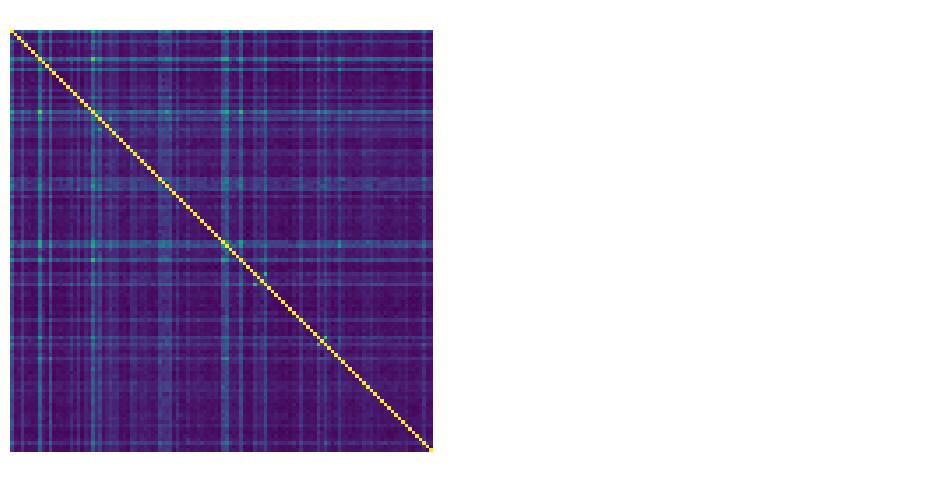

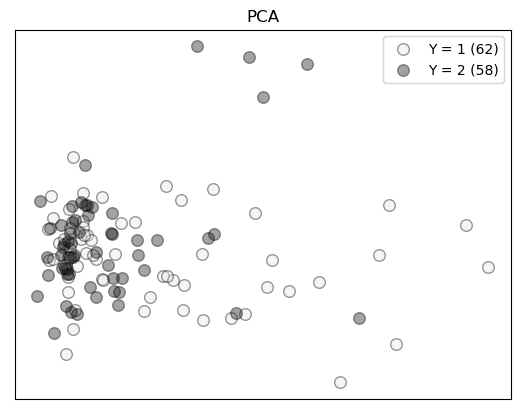

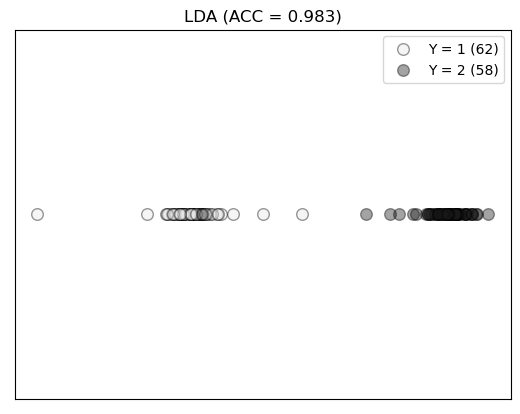

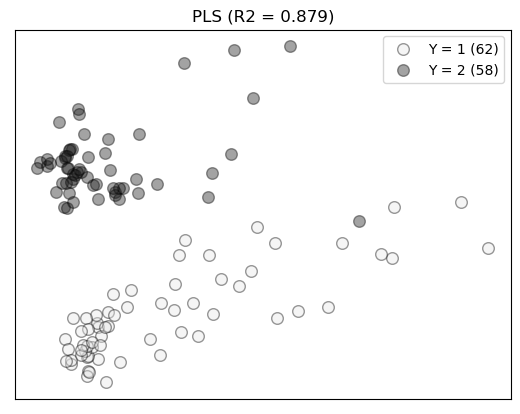

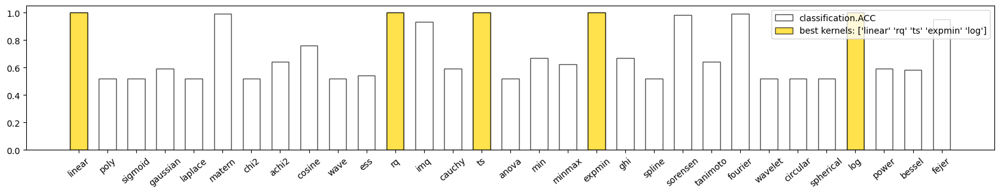

classification.ACC
best kernels: ['linear' 'rq' 'ts' 'expmin' 'log']
best value: 1.0


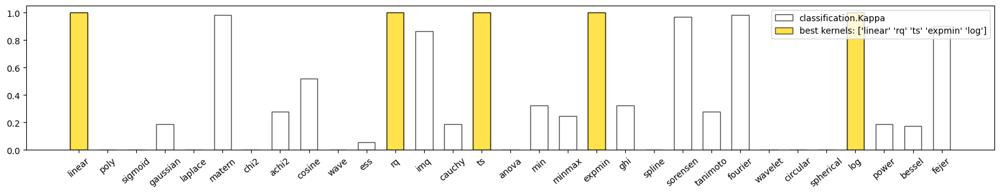

classification.Kappa
best kernels: ['linear' 'rq' 'ts' 'expmin' 'log']
best value: 1.0


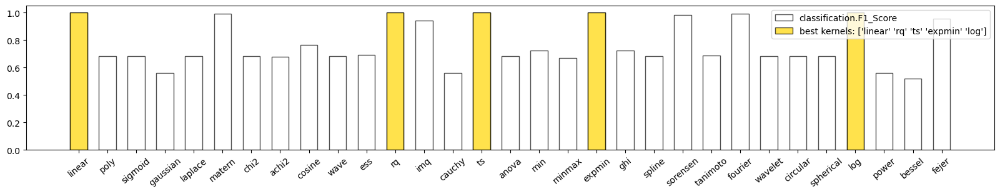

classification.F1_Score
best kernels: ['linear' 'rq' 'ts' 'expmin' 'log']
best value: 1.0


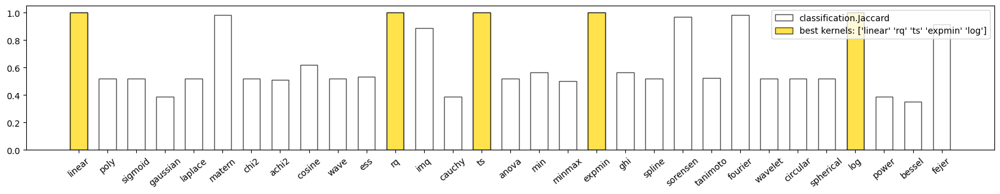

classification.Jaccard
best kernels: ['linear' 'rq' 'ts' 'expmin' 'log']
best value: 1.0


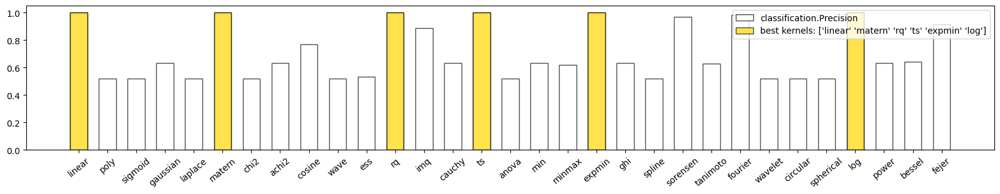

classification.Precision
best kernels: ['linear' 'matern' 'rq' 'ts' 'expmin' 'log']
best value: 1.0


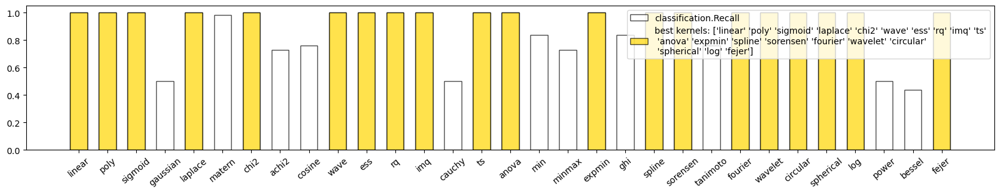

classification.Recall
best kernels: ['linear' 'poly' 'sigmoid' 'laplace' 'chi2' 'wave' 'ess' 'rq' 'imq' 'ts'
 'anova' 'expmin' 'spline' 'sorensen' 'fourier' 'wavelet' 'circular'
 'spherical' 'log' 'fejer']
best value: 1.0


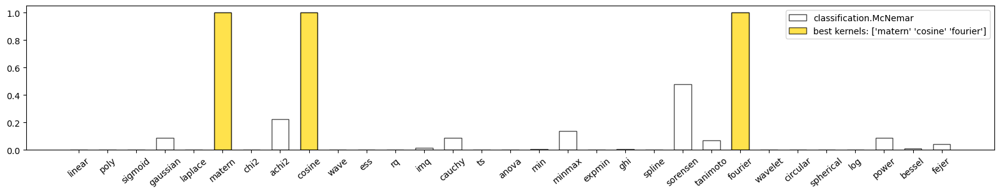

classification.McNemar
best kernels: ['matern' 'cosine' 'fourier']
best value: 1.0


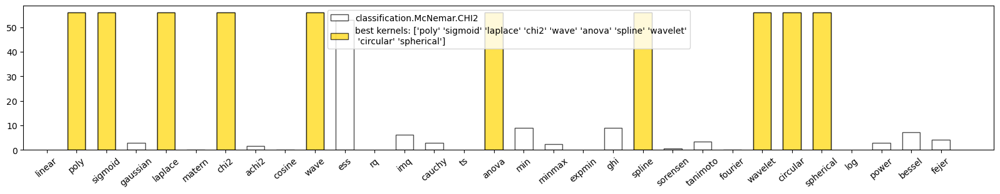

classification.McNemar.CHI2
best kernels: ['poly' 'sigmoid' 'laplace' 'chi2' 'wave' 'anova' 'spline' 'wavelet'
 'circular' 'spherical']
best value: 56.01724137931034


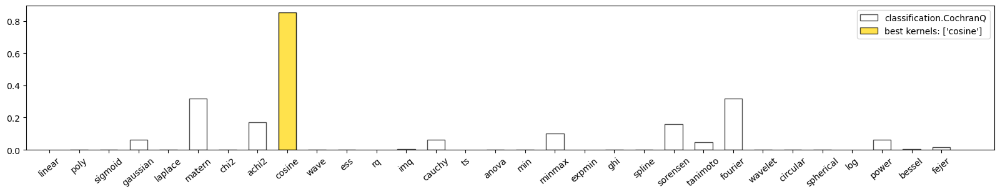

classification.CochranQ
best kernels: ['cosine']
best value: 0.8526836843346426


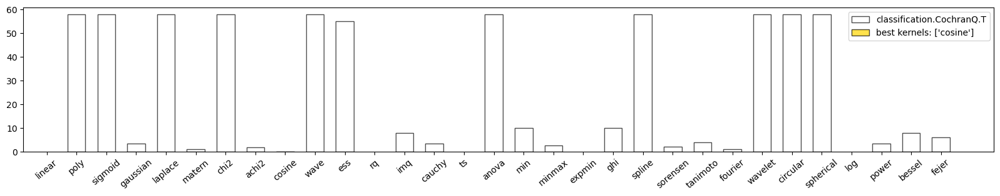

classification.CochranQ.T
best kernels: ['cosine']
best value: 0.034482758620689655


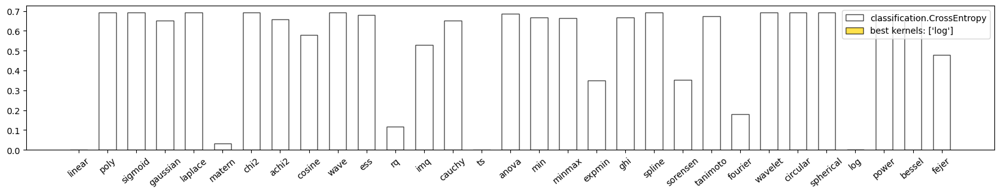

classification.CrossEntropy
best kernels: ['log']
best value: 0.0001914091638602778


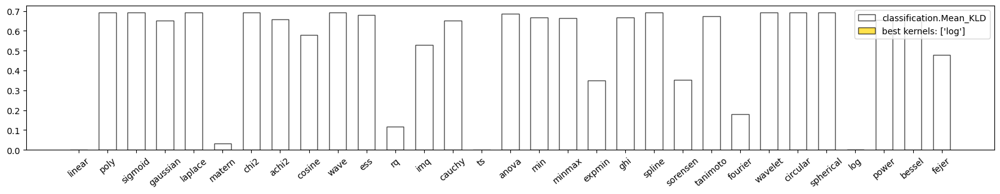

classification.Mean_KLD
best kernels: ['log']
best value: 0.0001914091638602755


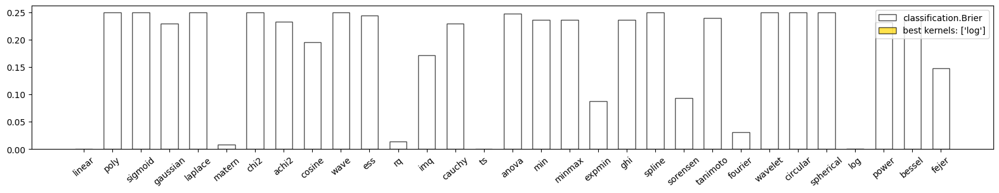

classification.Brier
best kernels: ['log']
best value: 1.311492375992908e-07


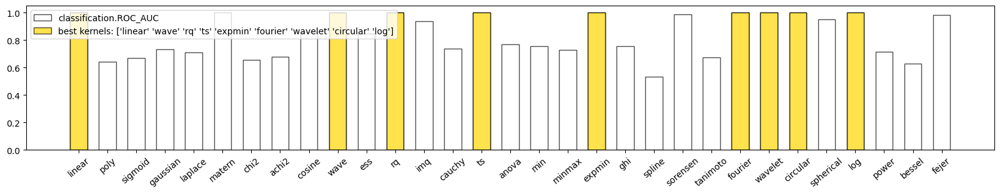

classification.ROC_AUC
best kernels: ['linear' 'wave' 'rq' 'ts' 'expmin' 'fourier' 'wavelet' 'circular' 'log']
best value: 1.0


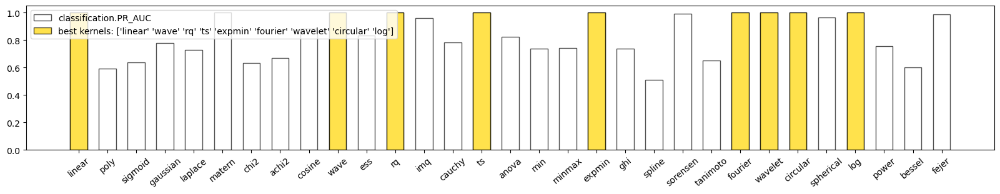

classification.PR_AUC
best kernels: ['linear' 'wave' 'rq' 'ts' 'expmin' 'fourier' 'wavelet' 'circular' 'log']
best value: 1.0


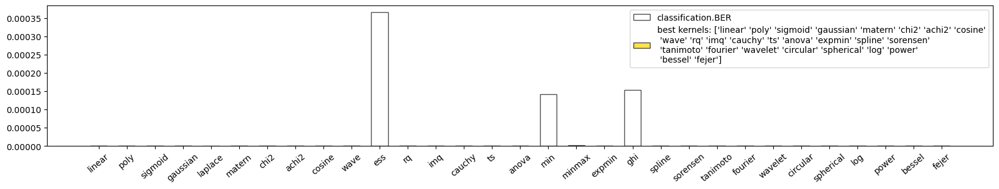

classification.BER
best kernels: ['linear' 'poly' 'sigmoid' 'gaussian' 'matern' 'chi2' 'achi2' 'cosine'
 'wave' 'rq' 'imq' 'cauchy' 'ts' 'anova' 'expmin' 'spline' 'sorensen'
 'tanimoto' 'fourier' 'wavelet' 'circular' 'spherical' 'log' 'power'
 'bessel' 'fejer']
best value: 0.0


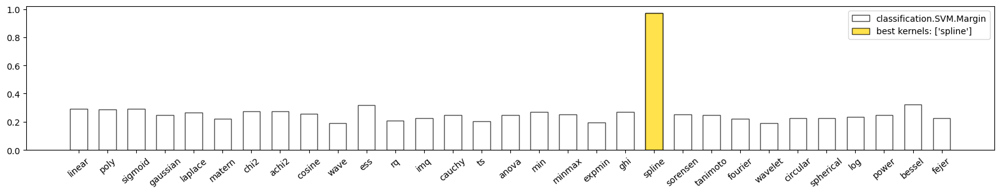

classification.SVM.Margin
best kernels: ['spline']
best value: 0.9712889638169998


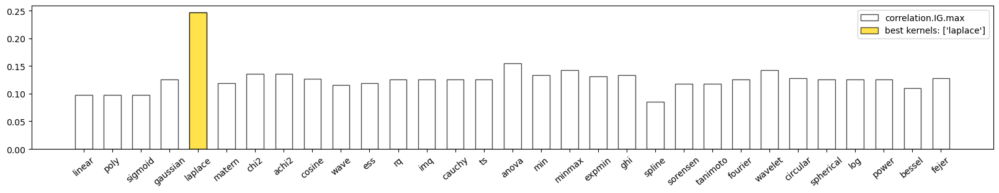

correlation.IG.max
best kernels: ['laplace']
best value: 0.24665312800005612


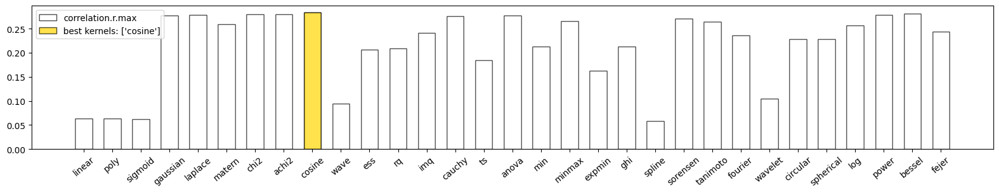

correlation.r.max
best kernels: ['cosine']
best value: 0.2838513098285293


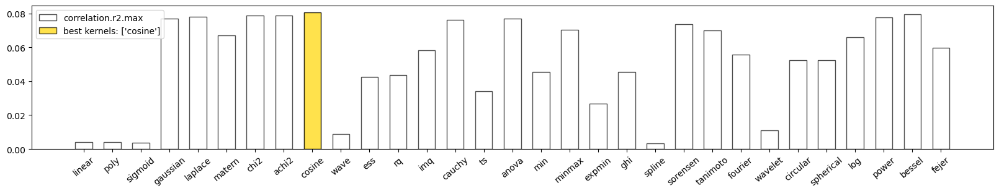

correlation.r2.max
best kernels: ['cosine']
best value: 0.08057156609137173


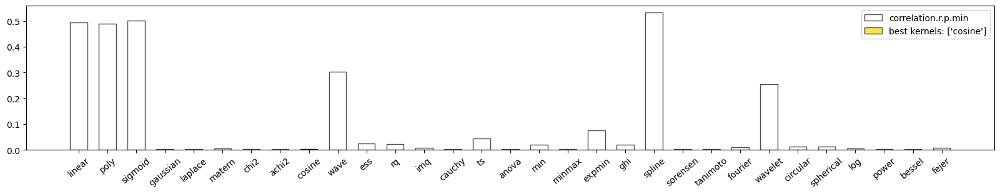

correlation.r.p.min
best kernels: ['cosine']
best value: 0.0016792758838866887


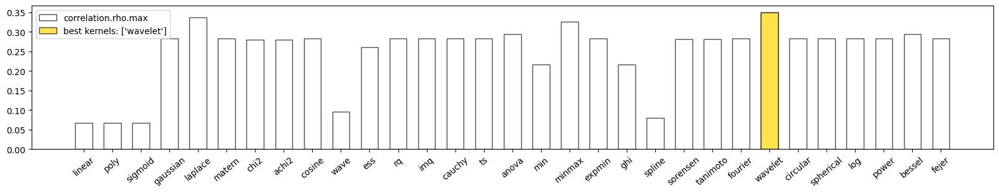

correlation.rho.max
best kernels: ['wavelet']
best value: 0.34998467375727954


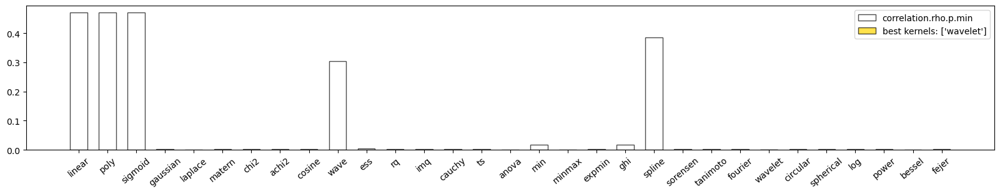

correlation.rho.p.min
best kernels: ['wavelet']
best value: 8.912651594614364e-05


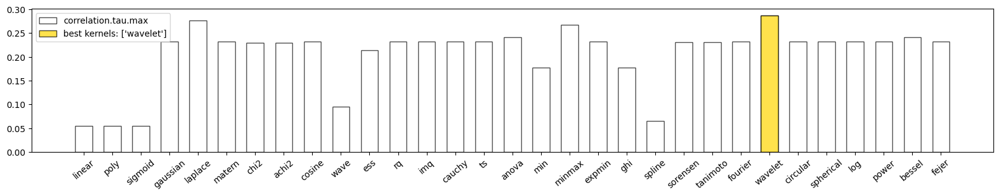

correlation.tau.max
best kernels: ['wavelet']
best value: 0.2869494912549334


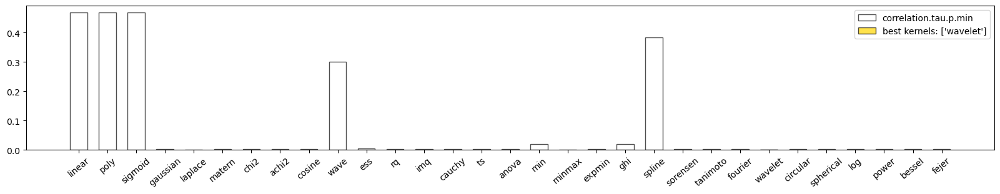

correlation.tau.p.min
best kernels: ['wavelet']
best value: 0.0001346022464697799


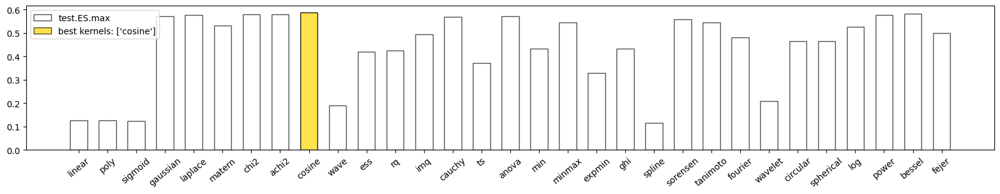

test.ES.max
best kernels: ['cosine']
best value: 0.5874267542869923


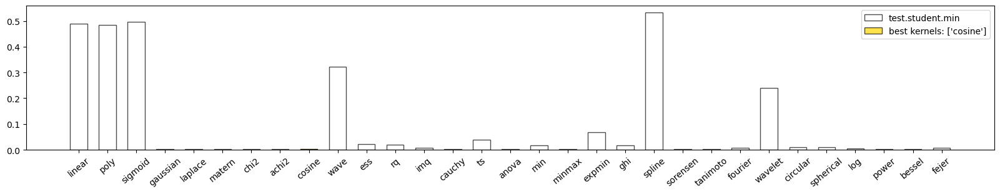

test.student.min
best kernels: ['cosine']
best value: 0.0014662431834658446


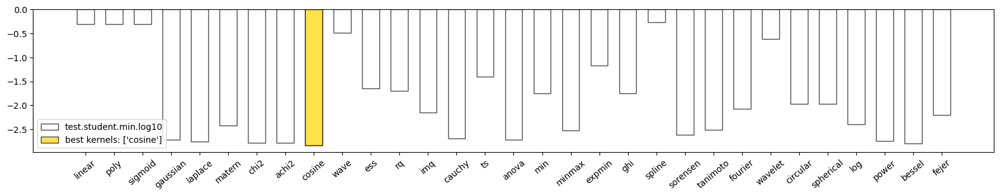

test.student.min.log10
best kernels: ['cosine']
best value: -2.833793993897762


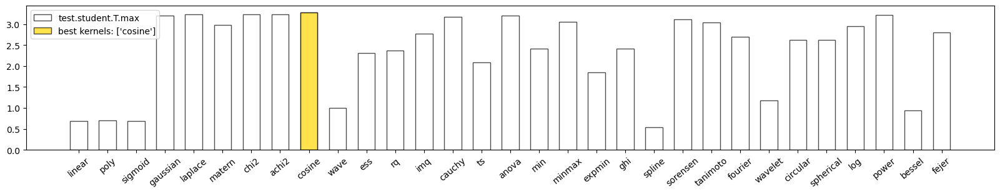

test.student.T.max
best kernels: ['cosine']
best value: 3.2814196126871895


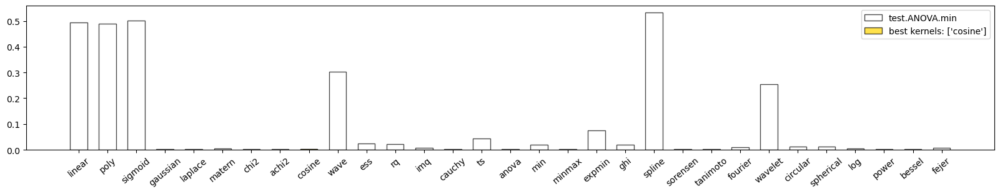

test.ANOVA.min
best kernels: ['cosine']
best value: 0.0016792758838867065


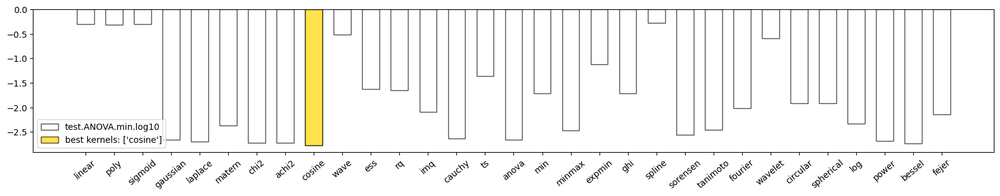

test.ANOVA.min.log10
best kernels: ['cosine']
best value: -2.7748779488845434


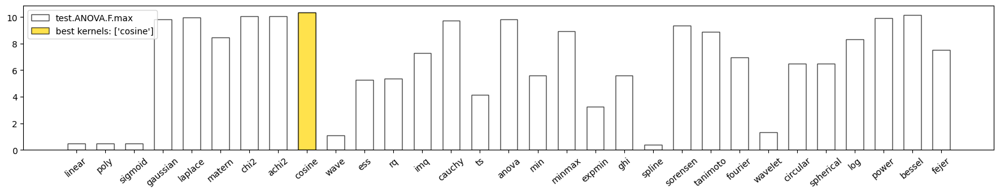

test.ANOVA.F.max
best kernels: ['cosine']
best value: 10.340603409842666


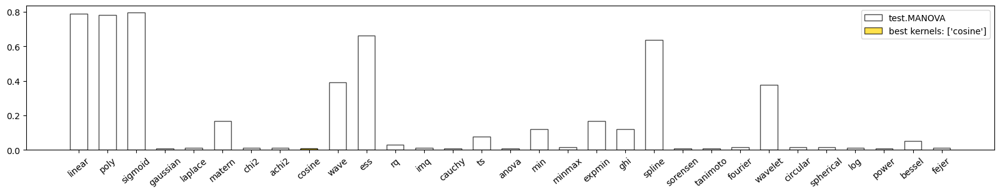

test.MANOVA
best kernels: ['cosine']
best value: 0.006019


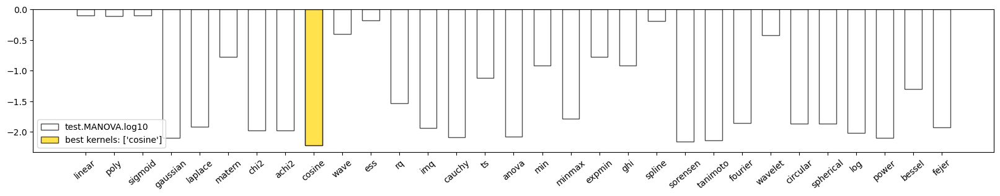

test.MANOVA.log10
best kernels: ['cosine']
best value: -2.22047565667521


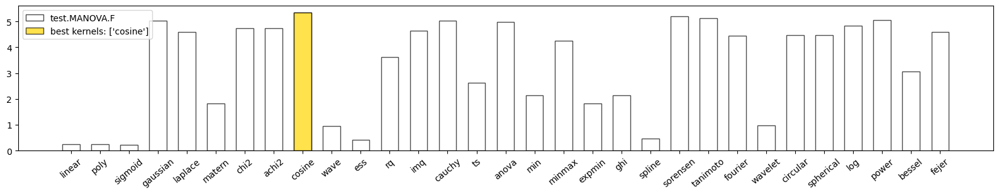

test.MANOVA.F
best kernels: ['cosine']
best value: 5.342878


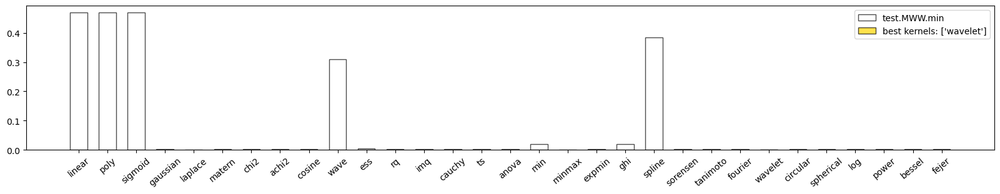

test.MWW.min
best kernels: ['wavelet']
best value: 0.00013604167358099


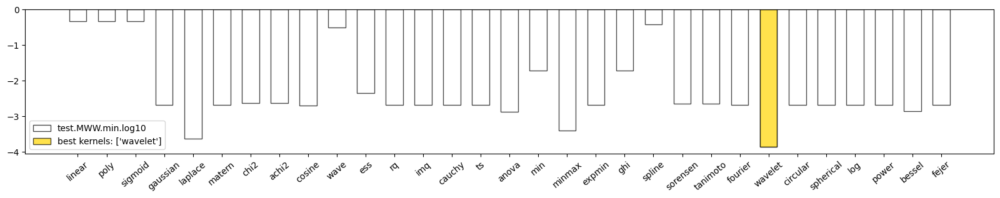

test.MWW.min.log10
best kernels: ['wavelet']
best value: -3.866328034027479


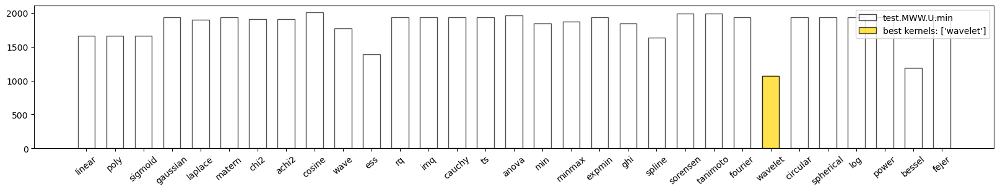

test.MWW.U.min
best kernels: ['wavelet']
best value: 1071.0


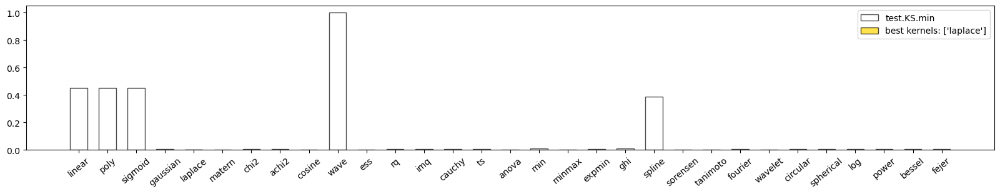

test.KS.min
best kernels: ['laplace']
best value: 0.00044038577950089586


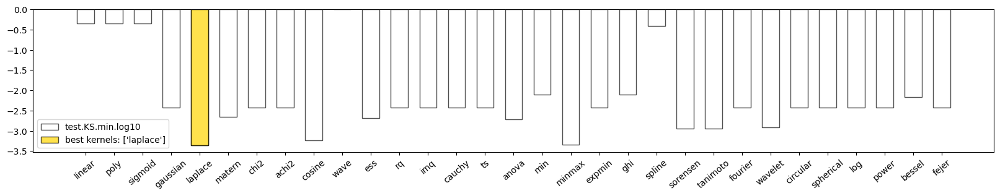

test.KS.min.log10
best kernels: ['laplace']
best value: -3.3561667132788564


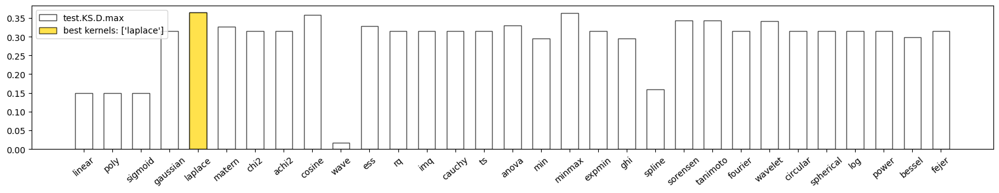

test.KS.D.max
best kernels: ['laplace']
best value: 0.36484983314794217


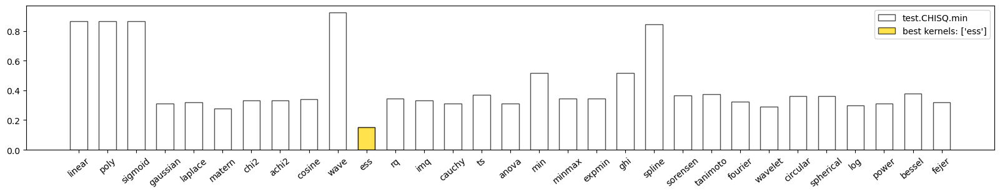

test.CHISQ.min
best kernels: ['ess']
best value: 0.1526140425281151


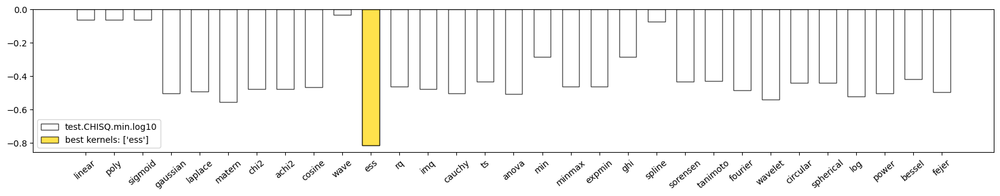

test.CHISQ.min.log10
best kernels: ['ess']
best value: -0.8164055036557922


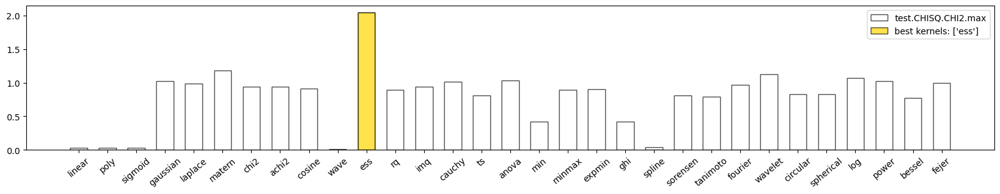

test.CHISQ.CHI2.max
best kernels: ['ess']
best value: 2.0459265370336532


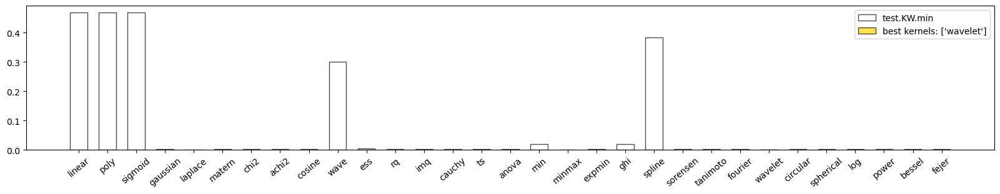

test.KW.min
best kernels: ['wavelet']
best value: 0.0001346022464697851


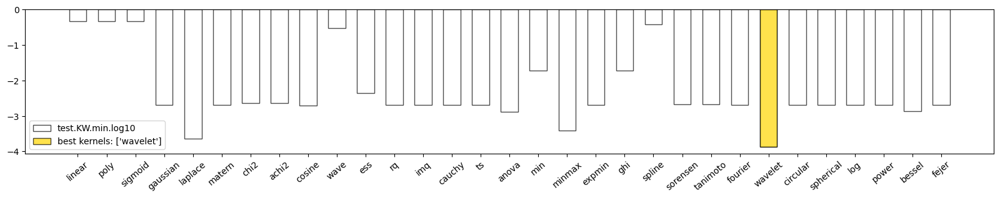

test.KW.min.log10
best kernels: ['wavelet']
best value: -3.8709476918112253


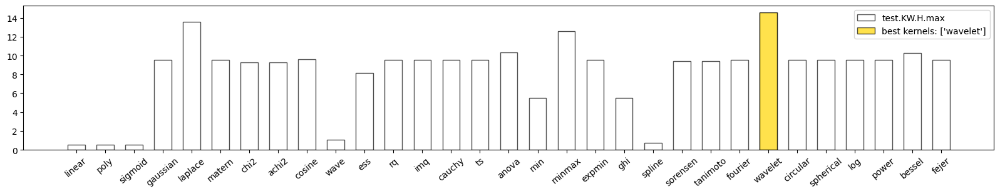

test.KW.H.max
best kernels: ['wavelet']
best value: 14.576223351933663


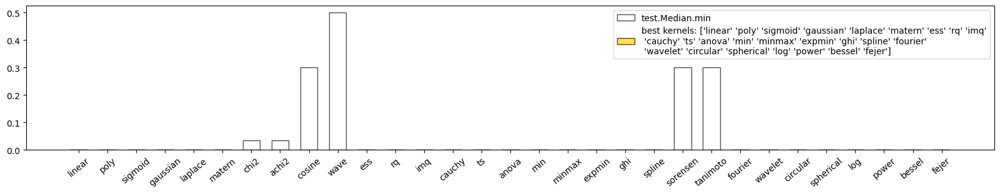

test.Median.min
best kernels: ['linear' 'poly' 'sigmoid' 'gaussian' 'laplace' 'matern' 'ess' 'rq' 'imq'
 'cauchy' 'ts' 'anova' 'min' 'minmax' 'expmin' 'ghi' 'spline' 'fourier'
 'wavelet' 'circular' 'spherical' 'log' 'power' 'bessel' 'fejer']
best value: 0.0


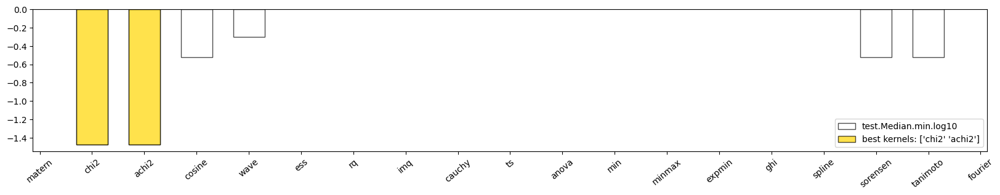

test.Median.min.log10
best kernels: ['chi2' 'achi2']
best value: -1.4766384370135663


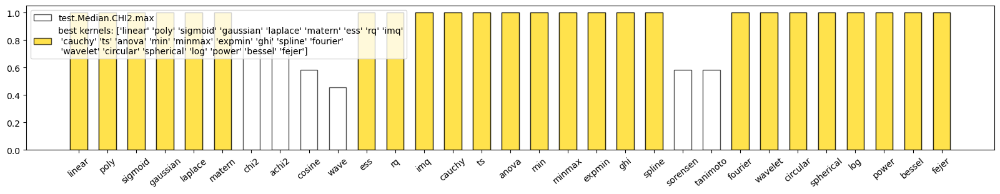

test.Median.CHI2.max
best kernels: ['linear' 'poly' 'sigmoid' 'gaussian' 'laplace' 'matern' 'ess' 'rq' 'imq'
 'cauchy' 'ts' 'anova' 'min' 'minmax' 'expmin' 'ghi' 'spline' 'fourier'
 'wavelet' 'circular' 'spherical' 'log' 'power' 'bessel' 'fejer']
best value: 1.0


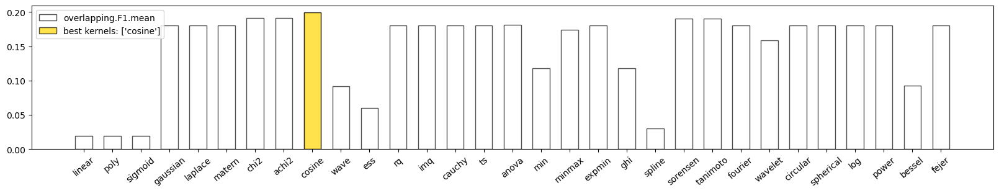

overlapping.F1.mean
best kernels: ['cosine']
best value: 0.19941183148158062


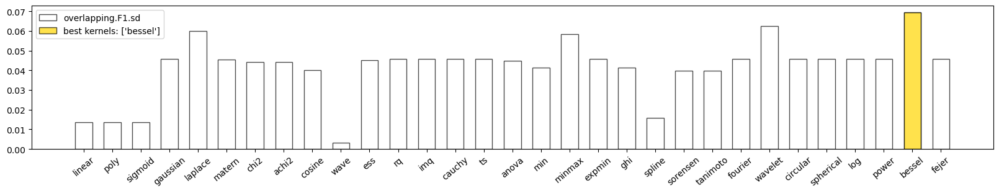

overlapping.F1.sd
best kernels: ['bessel']
best value: 0.0693812024079649


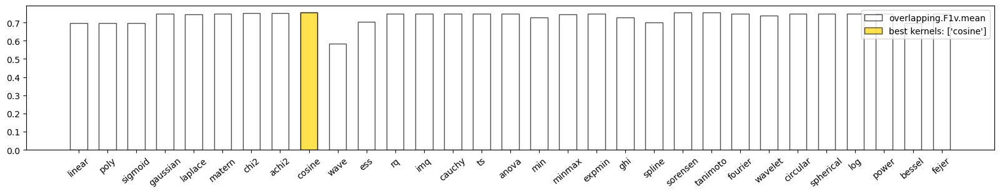

overlapping.F1v.mean
best kernels: ['cosine']
best value: 0.7555555555555555


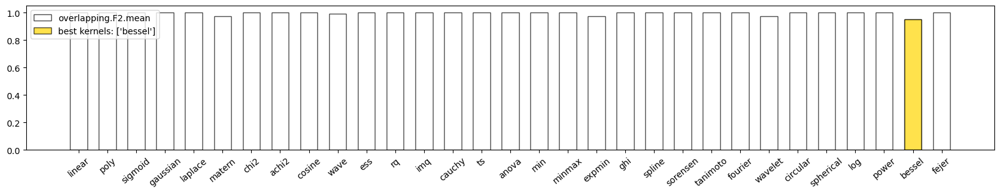

overlapping.F2.mean
best kernels: ['bessel']
best value: 0.95


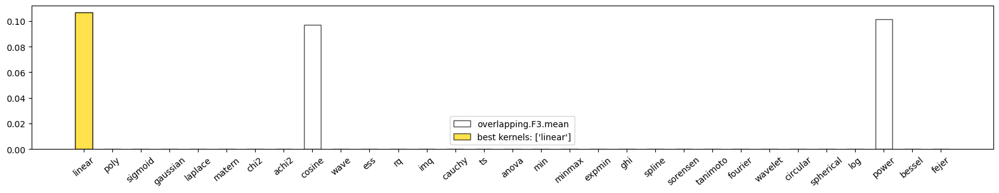

overlapping.F3.mean
best kernels: ['linear']
best value: 0.10678652777683761
All-NaN slice encountered


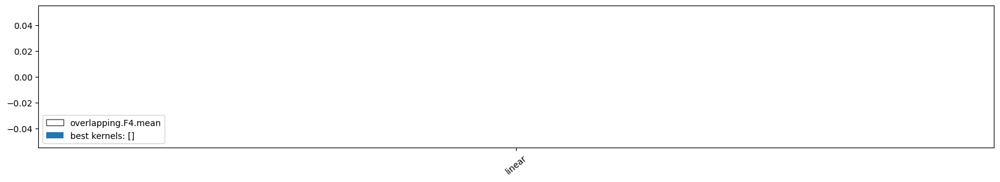

overlapping.F4.mean
best kernels: []
best value: None


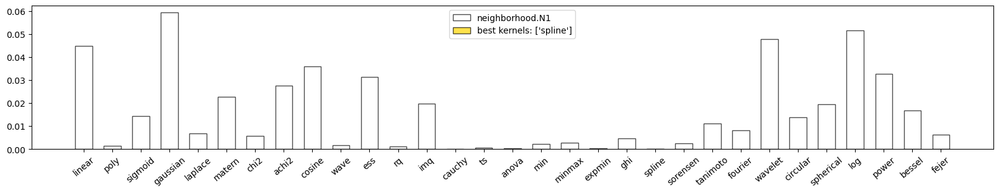

neighborhood.N1
best kernels: ['spline']
best value: 6.265393253001831e-07


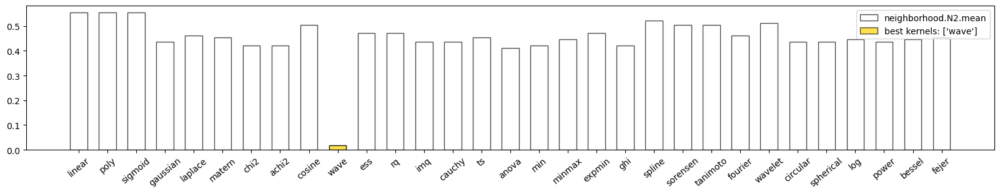

neighborhood.N2.mean
best kernels: ['wave']
best value: 0.01680672268907563


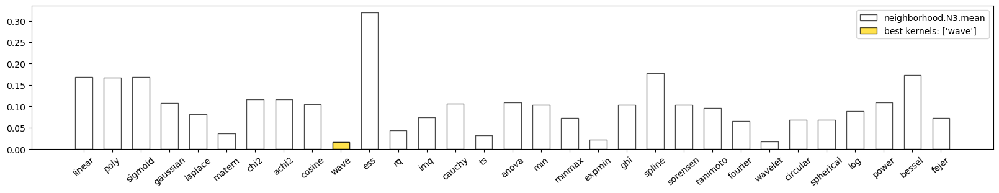

neighborhood.N3.mean
best kernels: ['wave']
best value: 0.016666666666666666


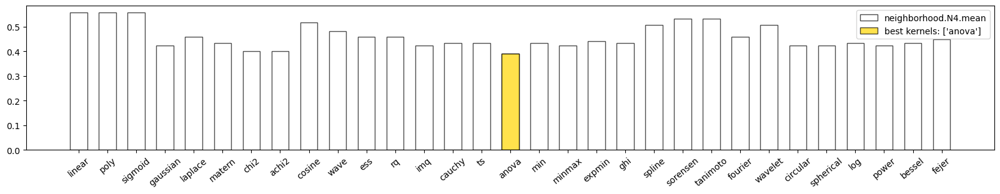

neighborhood.N4.mean
best kernels: ['anova']
best value: 0.39166666666666666


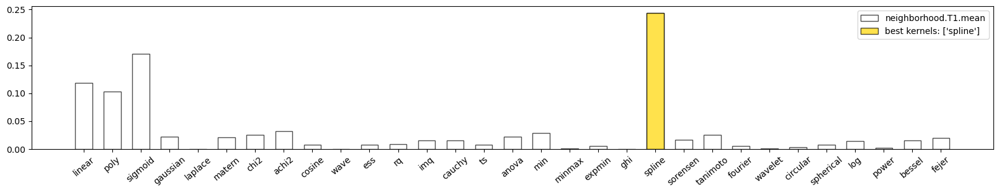

neighborhood.T1.mean
best kernels: ['spline']
best value: 0.24382042480496108


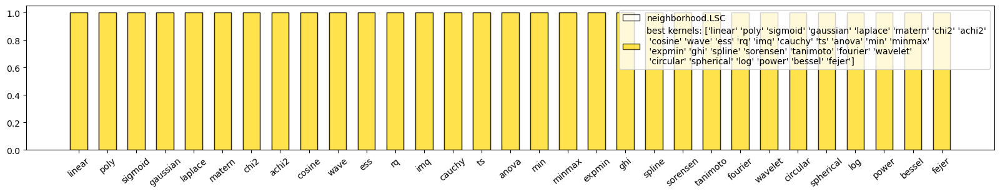

neighborhood.LSC
best kernels: ['linear' 'poly' 'sigmoid' 'gaussian' 'laplace' 'matern' 'chi2' 'achi2'
 'cosine' 'wave' 'ess' 'rq' 'imq' 'cauchy' 'ts' 'anova' 'min' 'minmax'
 'expmin' 'ghi' 'spline' 'sorensen' 'tanimoto' 'fourier' 'wavelet'
 'circular' 'spherical' 'log' 'power' 'bessel' 'fejer']
best value: 1.0


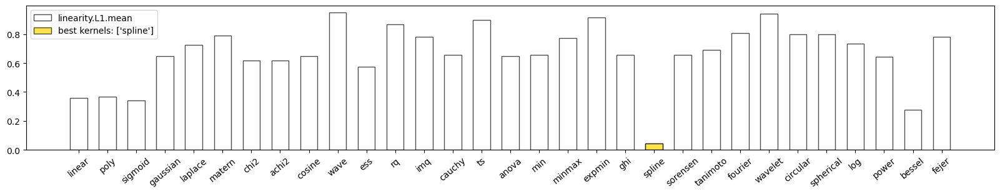

linearity.L1.mean
best kernels: ['spline']
best value: 0.041666666666666664


,linear,poly,sigmoid,gaussian,laplace,matern,chi2,achi2,cosine,wave,ess,rq,imq,cauchy,ts,anova,min,minmax,expmin,ghi,spline,sorensen,tanimoto,fourier,wavelet,circular,spherical,log,power,bessel,fejer,best kernel(s)
classification.ACC,1.0,0.517,0.517,0.592,0.517,0.992,0.517,0.642,0.758,0.517,0.542,1.0,0.933,0.592,1.0,0.517,0.667,0.625,1.0,0.667,0.517,0.983,0.642,0.992,0.517,0.517,0.517,1.0,0.592,0.583,0.95,['linear' 'rq' 'ts' 'expmin' 'log']
classification.Kappa,1.0,0.0,0.0,0.188,0.0,0.983,0.0,0.279,0.516,0.0,0.053,1.0,0.866,0.188,1.0,0.0,0.325,0.245,1.0,0.325,0.0,0.967,0.277,0.983,0.0,0.0,0.0,1.0,0.188,0.175,0.9,['linear' 'rq' 'ts' 'expmin' 'log']
classification.F1_Score,1.0,0.681,0.681,0.559,0.681,0.992,0.681,0.677,0.764,0.681,0.693,1.0,0.939,0.559,1.0,0.681,0.722,0.667,1.0,0.722,0.681,0.984,0.686,0.992,0.681,0.681,0.681,1.0,0.559,0.519,0.954,['linear' 'rq' 'ts' 'expmin' 'log']
classification.Jaccard,1.0,0.517,0.517,0.388,0.517,0.984,0.517,0.511,0.618,0.517,0.53,1.0,0.886,0.388,1.0,0.517,0.565,0.5,1.0,0.565,0.517,0.969,0.522,0.984,0.517,0.517,0.517,1.0,0.388,0.351,0.912,['linear' 'rq' 'ts' 'expmin' 'log']
classification.Precision,1.0,0.517,0.517,0.633,0.517,1.0,0.517,0.634,0.77,0.517,0.53,1.0,0.886,0.633,1.0,0.517,0.634,0.616,1.0,0.634,0.517,0.969,0.627,0.984,0.517,0.517,0.517,1.0,0.633,0.643,0.912,['linear' 'matern' 'rq' 'ts' 'expmin' 'log']
classification.Recall,1.0,1.0,1.0,0.5,1.0,0.984,1.0,0.726,0.758,1.0,1.0,1.0,1.0,0.5,1.0,1.0,0.839,0.726,1.0,0.839,1.0,1.0,0.758,1.0,1.0,1.0,1.0,1.0,0.5,0.435,1.0,['linear' 'poly' 'sigmoid' 'laplace' 'chi2' 'wave' 'ess' 'rq' 'imq' 'ts' 'anova' 'expmin' 'spline' 'sorensen' 'fourier' 'wavelet' 'circular' 'spherical' 'log' 'fejer']
classification.McNemar,0.0,0.0,0.0,0.086,0.0,1.0,0.0,0.222,1.0,0.0,0.0,0.0,0.013,0.086,0.0,0.0,0.003,0.136,0.0,0.003,0.0,0.48,0.067,1.0,0.0,0.0,0.0,0.0,0.086,0.007,0.041,['matern' 'cosine' 'fourier']
classification.McNemar.CHI2,inf,56.017,56.017,2.939,56.017,0.0,56.017,1.488,0.0,56.017,53.018,inf,6.125,2.939,inf,56.017,9.025,2.222,inf,9.025,56.017,0.5,3.349,0.0,56.017,56.017,56.017,inf,2.939,7.22,4.167,['poly' 'sigmoid' 'laplace' 'chi2' 'wave' 'anova' 'spline' 'wavelet' 'circular' 'spherical']
classification.CochranQ,nan,0.0,0.0,0.063,0.0,0.317,0.0,0.17,0.853,0.0,0.0,nan,0.005,0.063,nan,0.0,0.002,0.101,nan,0.002,0.0,0.157,0.047,0.317,0.0,0.0,0.0,nan,0.063,0.005,0.014,['cosine']
classification.CochranQ.T,nan,58.0,58.0,3.449,58.0,1.0,58.0,1.884,0.034,58.0,55.0,nan,8.0,3.449,nan,58.0,10.0,2.689,nan,10.0,58.0,2.0,3.93,1.0,58.0,58.0,58.0,nan,3.449,8.0,6.0,['cosine']


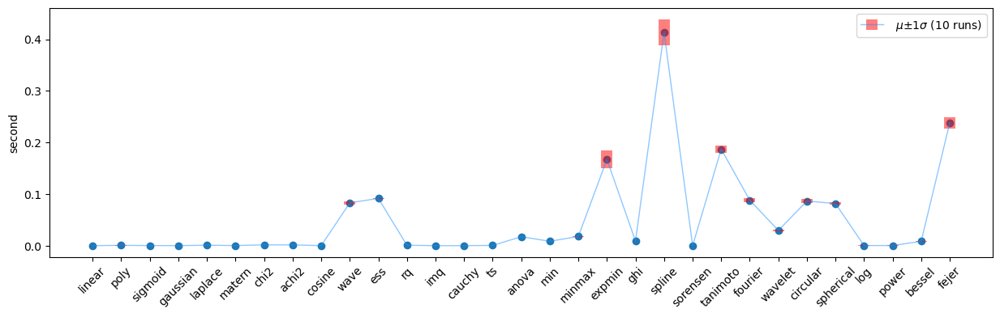

Averaged run time:  {'linear': 0.000618589999987762, 'poly': 0.0010913900000218747, 'sigmoid': 0.0007483200000137913, 'gaussian': 0.0006399699999860786, 'laplace': 0.0013699600000222744, 'matern': 0.0007623599999874387, 'chi2': 0.0020735999999828892, 'achi2': 0.00201113999997915, 'cosine': 0.0005740099999911763, 'wave': 0.08341652999998814, 'ess': 0.09197955000000775, 'rq': 0.001328080000018872, 'imq': 0.0005824099999927057, 'cauchy': 0.0005661599999939426, 'ts': 0.0010087299999781863, 'anova': 0.017778920000000652, 'min': 0.00905092999998942, 'minmax': 0.01826334999999517, 'expmin': 0.1674787100000117, 'ghi': 0.009368940000013027, 'spline': 0.4136079799999834, 'sorensen': 0.0005327899999997499, 'tanimoto': 0.18720407999999225, 'fourier': 0.08853383000000577, 'wavelet': 0.029926030000001446, 'circular': 0.08686496999997644, 'spherical': 0.0820208999999977, 'log': 0.0007851599999867176, 'power': 0.0007796700000085366, 'bessel': 0.008948929999996835, 'fejer': 0.23847711999997045}


In [5]:
analyze_dataset('salt')

load dataset from 7345.csv
Use classes: [0, 3], remapped to [0, 1]
X.shape (153, 3000)  y.shape (153,)


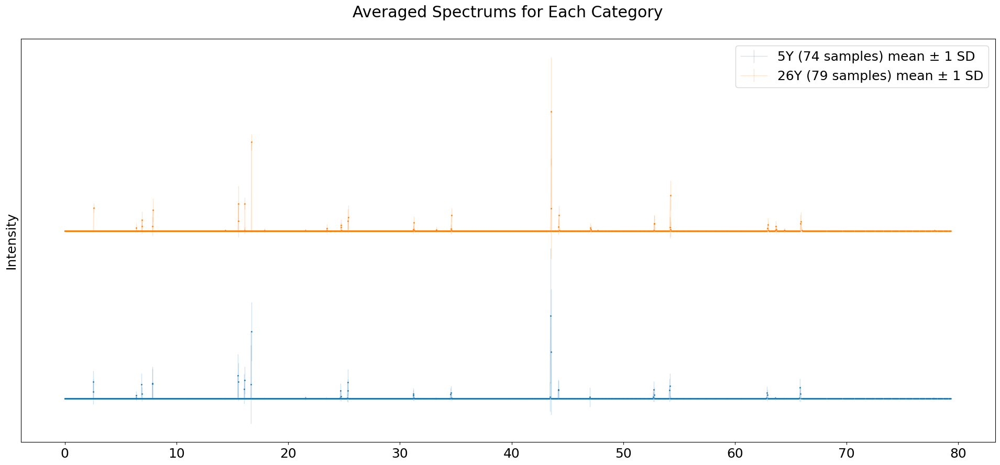

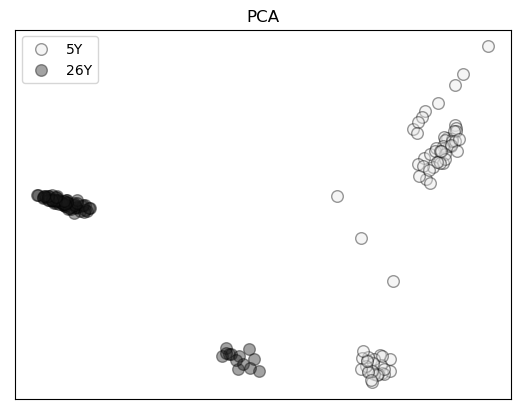

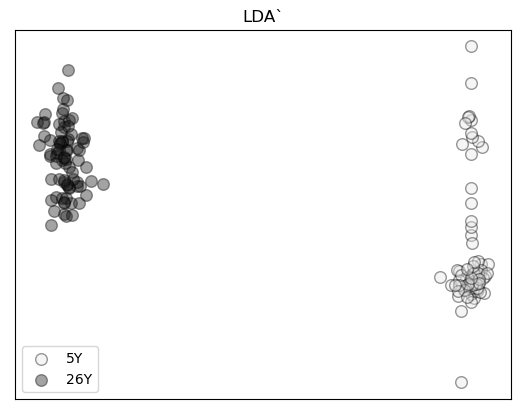

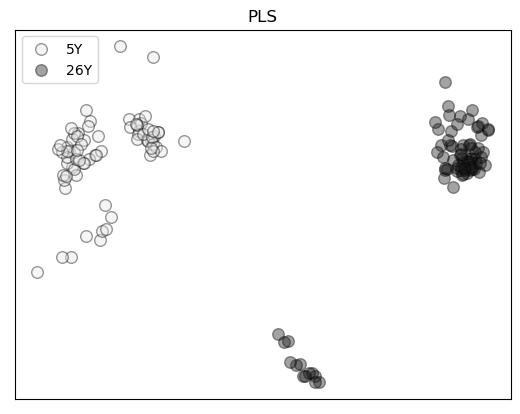

古井贡酒不同年份白酒 SPI-MS of Gujing Tribute wine of different vintages

["5年","8年","16年","26年"]
KW Exception:  All numbers are identical in kruskal
MedianTest Exception:  All values are below the grand median (0.0).


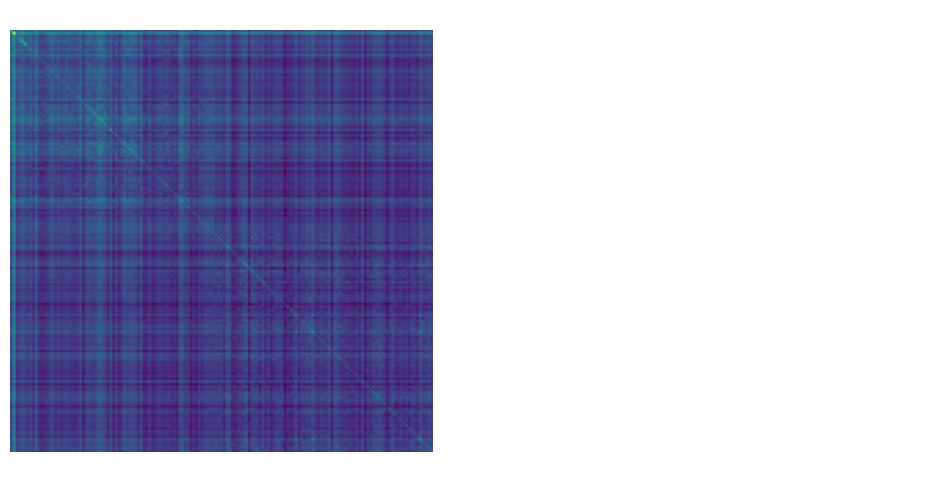

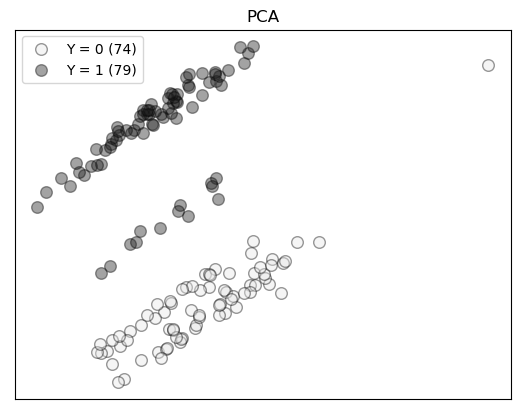

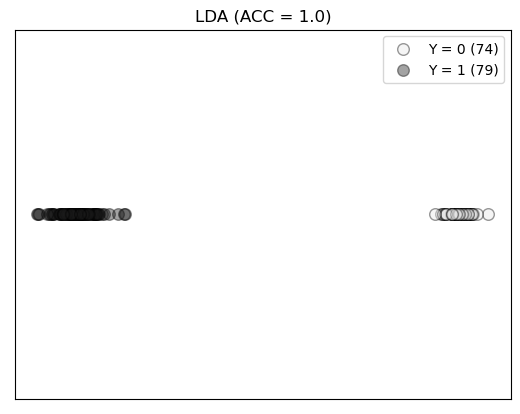

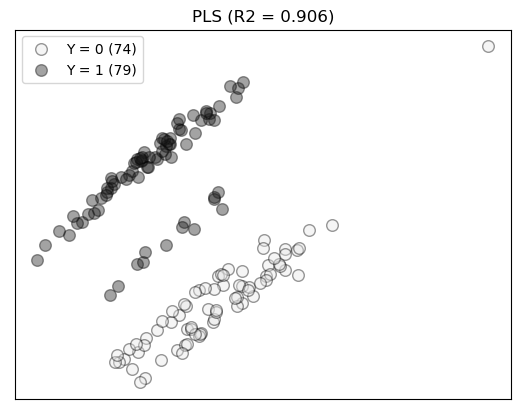

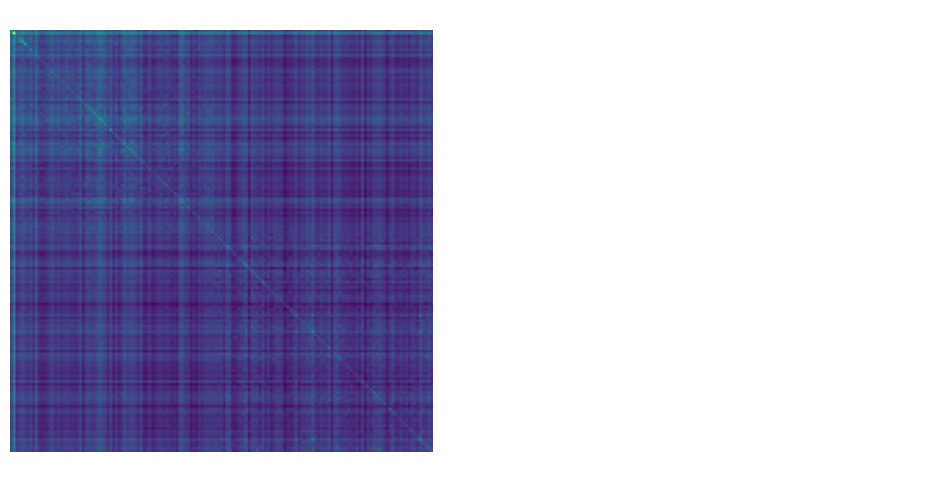

...

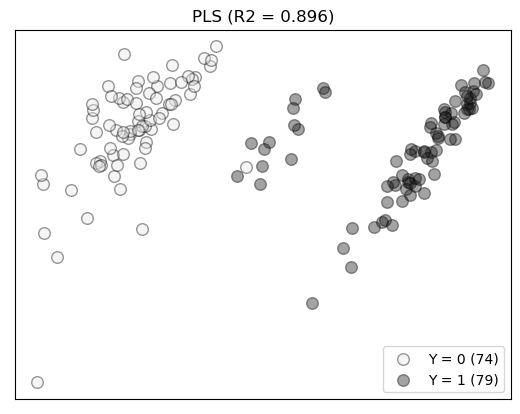

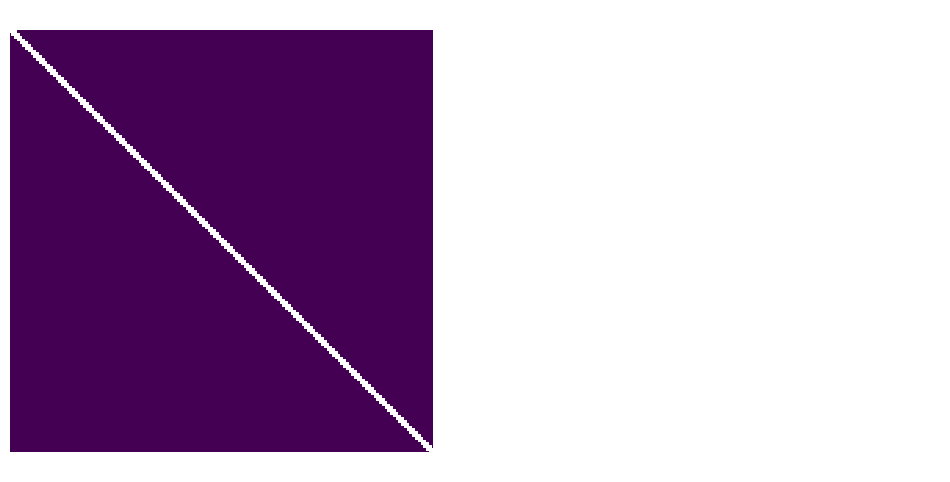

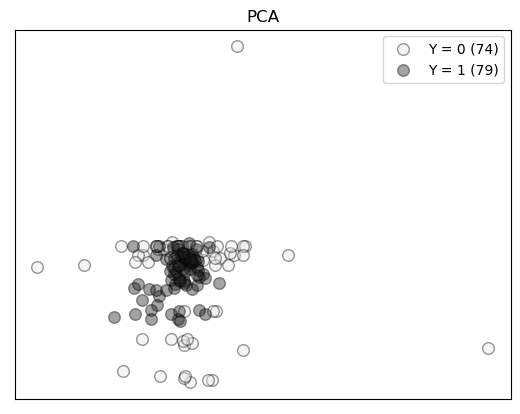

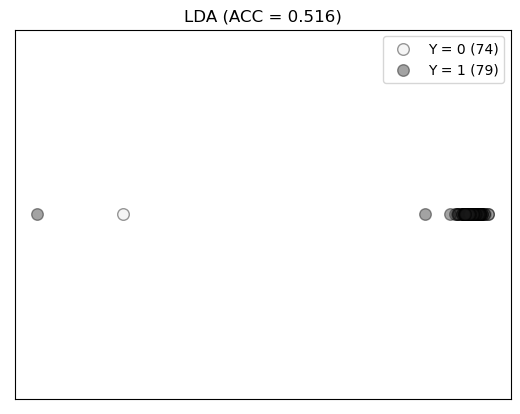

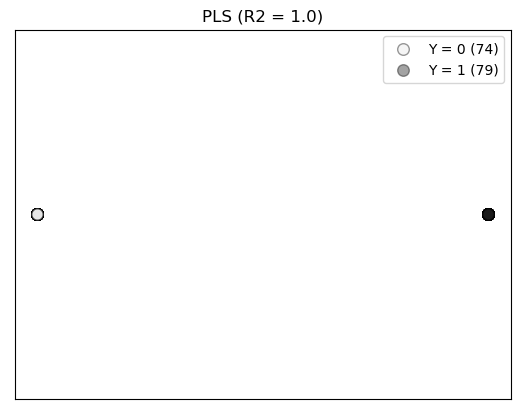

MedianTest Exception:  All values are below the grand median (1.0).


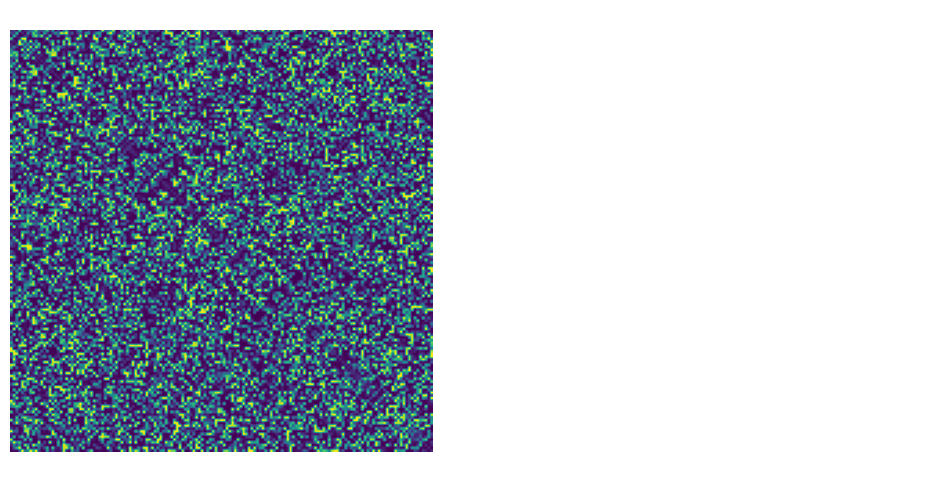

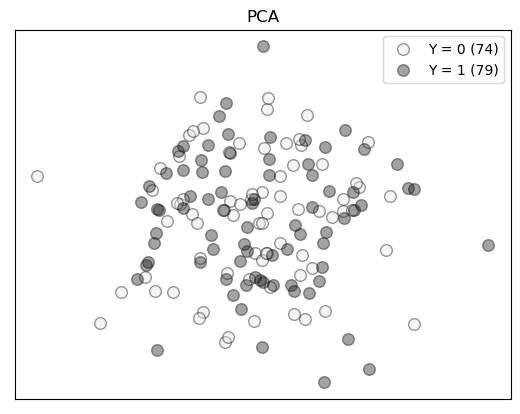

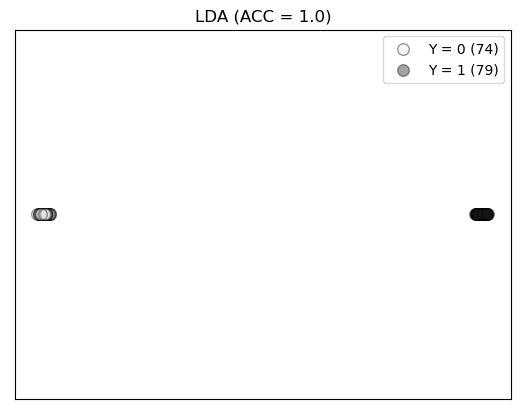

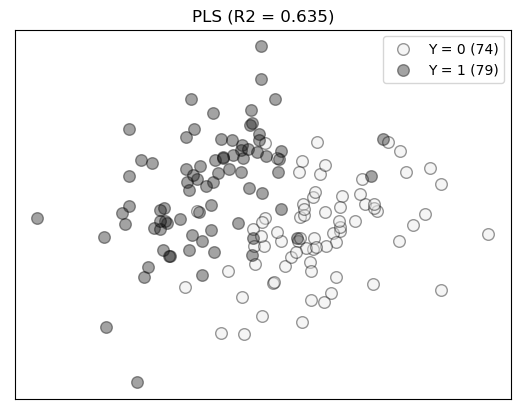

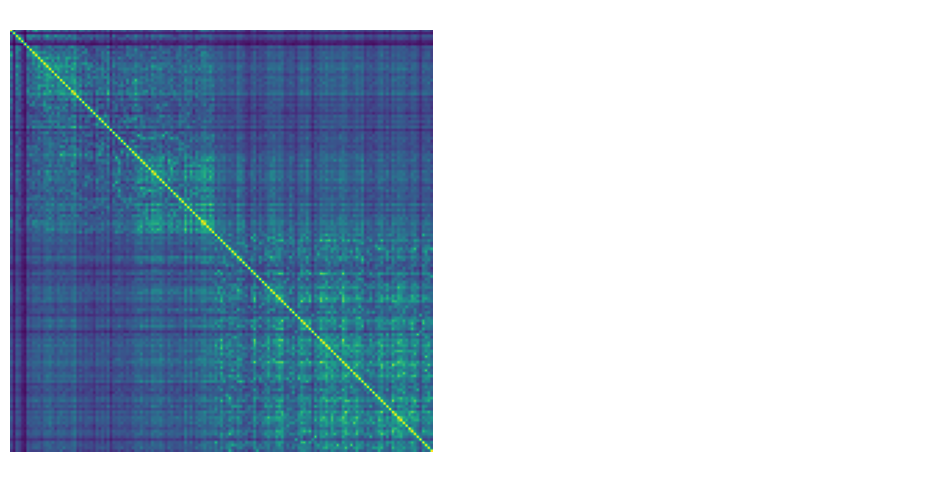

...

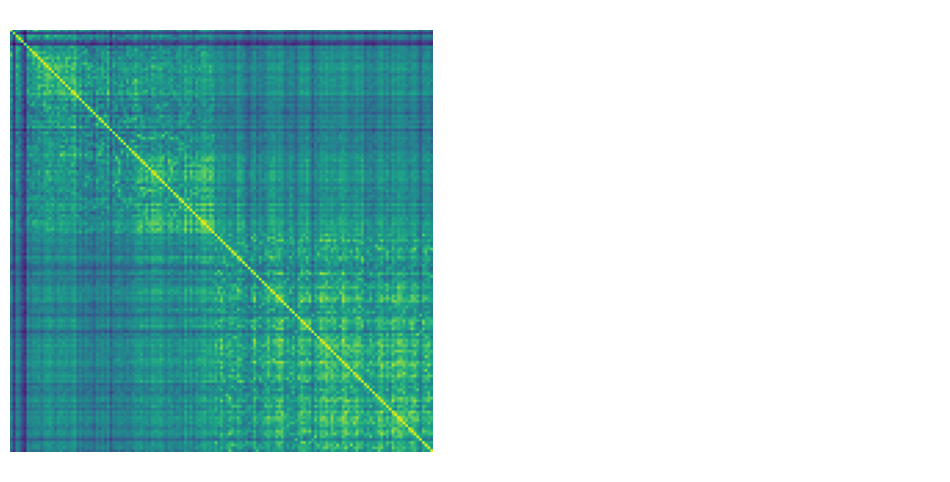

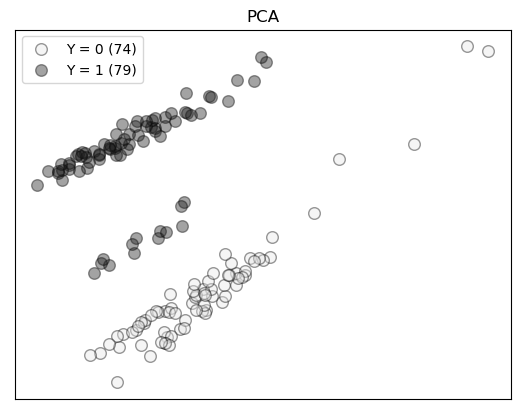

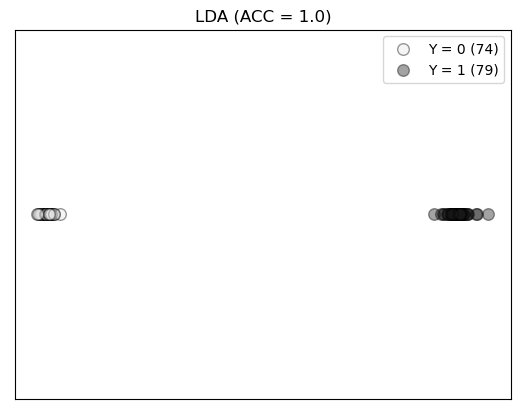

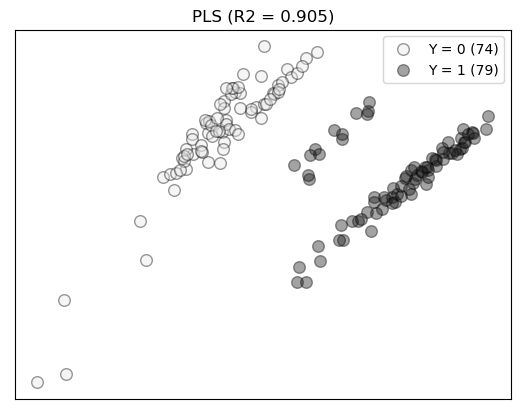

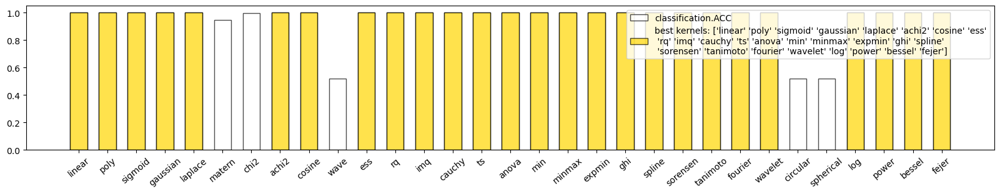

classification.ACC
best kernels: ['linear' 'poly' 'sigmoid' 'gaussian' 'laplace' 'achi2' 'cosine' 'ess'
 'rq' 'imq' 'cauchy' 'ts' 'anova' 'min' 'minmax' 'expmin' 'ghi' 'spline'
 'sorensen' 'tanimoto' 'fourier' 'wavelet' 'log' 'power' 'bessel' 'fejer']
best value: 1.0


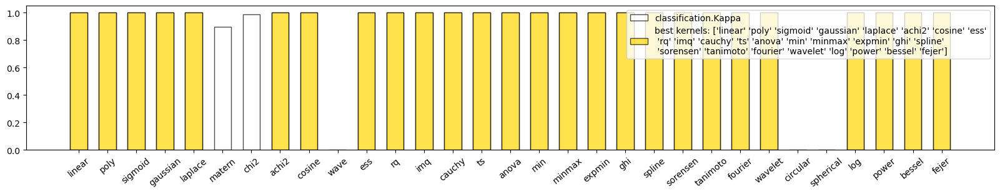

classification.Kappa
best kernels: ['linear' 'poly' 'sigmoid' 'gaussian' 'laplace' 'achi2' 'cosine' 'ess'
 'rq' 'imq' 'cauchy' 'ts' 'anova' 'min' 'minmax' 'expmin' 'ghi' 'spline'
 'sorensen' 'tanimoto' 'fourier' 'wavelet' 'log' 'power' 'bessel' 'fejer']
best value: 1.0


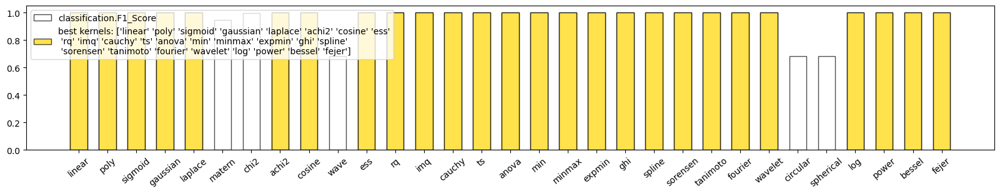

classification.F1_Score
best kernels: ['linear' 'poly' 'sigmoid' 'gaussian' 'laplace' 'achi2' 'cosine' 'ess'
 'rq' 'imq' 'cauchy' 'ts' 'anova' 'min' 'minmax' 'expmin' 'ghi' 'spline'
 'sorensen' 'tanimoto' 'fourier' 'wavelet' 'log' 'power' 'bessel' 'fejer']
best value: 1.0


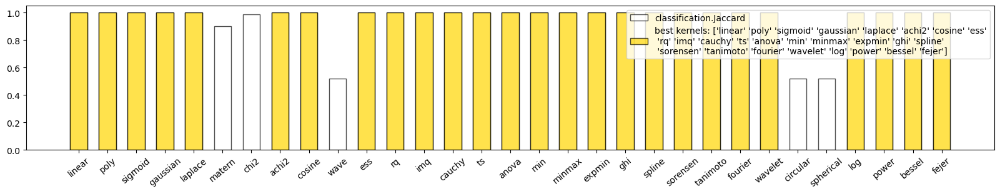

classification.Jaccard
best kernels: ['linear' 'poly' 'sigmoid' 'gaussian' 'laplace' 'achi2' 'cosine' 'ess'
 'rq' 'imq' 'cauchy' 'ts' 'anova' 'min' 'minmax' 'expmin' 'ghi' 'spline'
 'sorensen' 'tanimoto' 'fourier' 'wavelet' 'log' 'power' 'bessel' 'fejer']
best value: 1.0


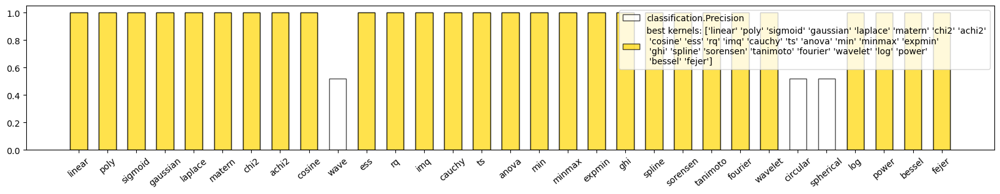

classification.Precision
best kernels: ['linear' 'poly' 'sigmoid' 'gaussian' 'laplace' 'matern' 'chi2' 'achi2'
 'cosine' 'ess' 'rq' 'imq' 'cauchy' 'ts' 'anova' 'min' 'minmax' 'expmin'
 'ghi' 'spline' 'sorensen' 'tanimoto' 'fourier' 'wavelet' 'log' 'power'
 'bessel' 'fejer']
best value: 1.0


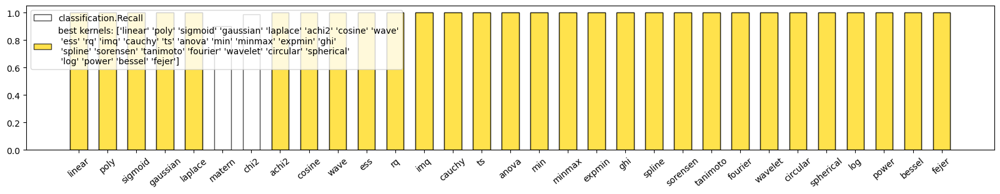

classification.Recall
best kernels: ['linear' 'poly' 'sigmoid' 'gaussian' 'laplace' 'achi2' 'cosine' 'wave'
 'ess' 'rq' 'imq' 'cauchy' 'ts' 'anova' 'min' 'minmax' 'expmin' 'ghi'
 'spline' 'sorensen' 'tanimoto' 'fourier' 'wavelet' 'circular' 'spherical'
 'log' 'power' 'bessel' 'fejer']
best value: 1.0


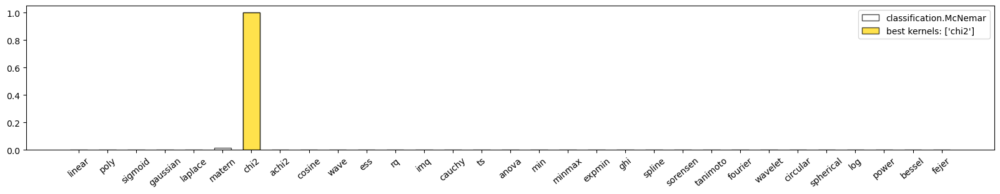

classification.McNemar
best kernels: ['chi2']
best value: 1.0


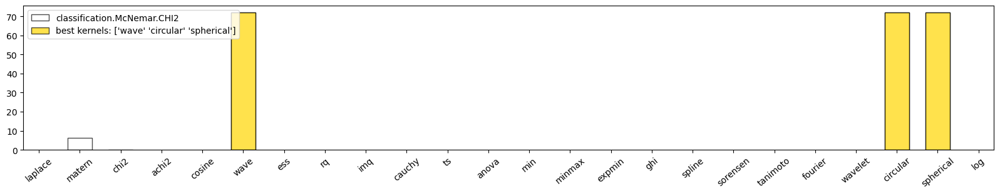

classification.McNemar.CHI2
best kernels: ['wave' 'circular' 'spherical']
best value: 72.01351351351352


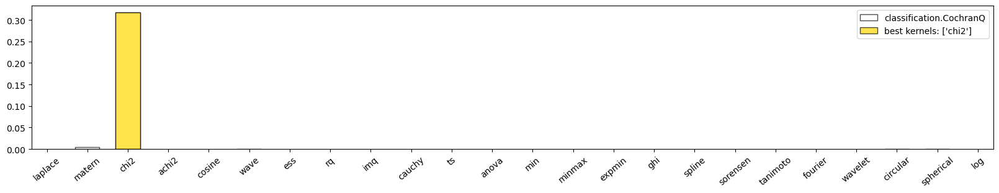

classification.CochranQ
best kernels: ['chi2']
best value: 0.31731050786291115


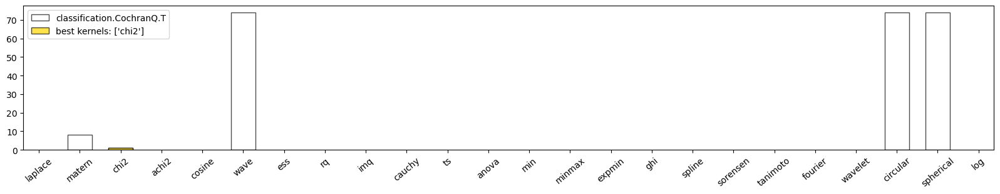

classification.CochranQ.T
best kernels: ['chi2']
best value: 1.0


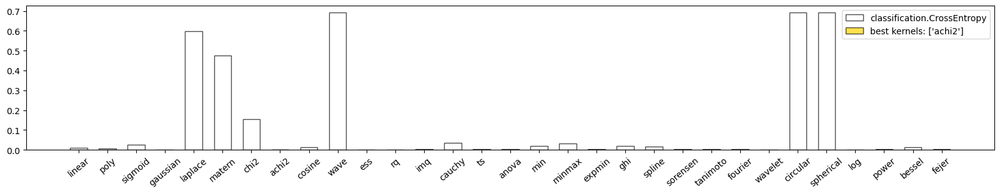

classification.CrossEntropy
best kernels: ['achi2']
best value: 1.3331506001729166e-05


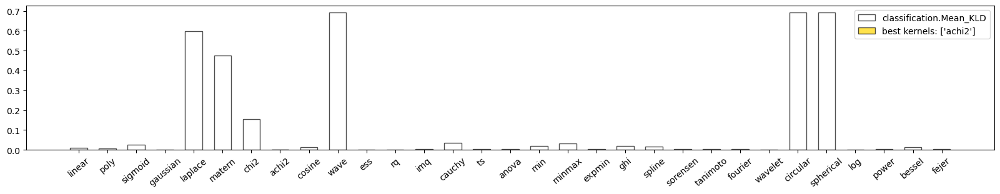

classification.Mean_KLD
best kernels: ['achi2']
best value: 1.3331506001723006e-05


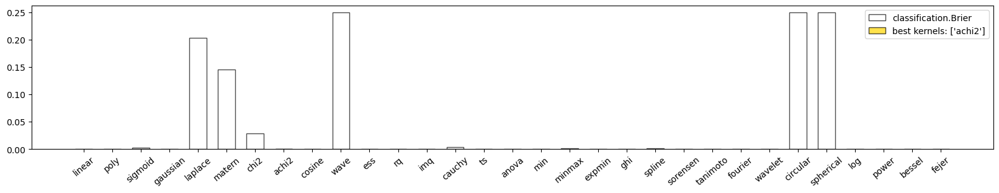

classification.Brier
best kernels: ['achi2']
best value: 9.672866578138463e-10


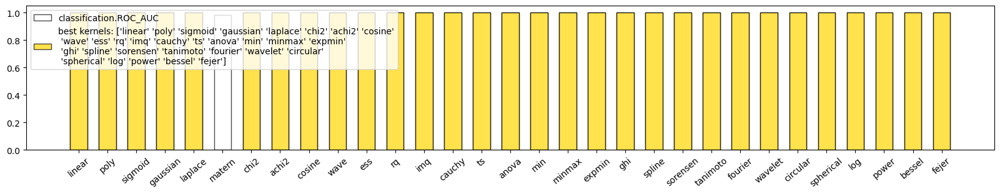

classification.ROC_AUC
best kernels: ['linear' 'poly' 'sigmoid' 'gaussian' 'laplace' 'chi2' 'achi2' 'cosine'
 'wave' 'ess' 'rq' 'imq' 'cauchy' 'ts' 'anova' 'min' 'minmax' 'expmin'
 'ghi' 'spline' 'sorensen' 'tanimoto' 'fourier' 'wavelet' 'circular'
 'spherical' 'log' 'power' 'bessel' 'fejer']
best value: 1.0


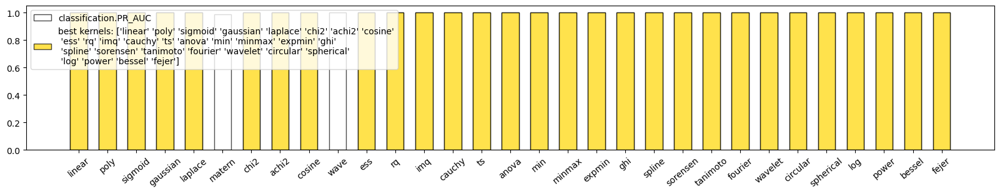

classification.PR_AUC
best kernels: ['linear' 'poly' 'sigmoid' 'gaussian' 'laplace' 'chi2' 'achi2' 'cosine'
 'ess' 'rq' 'imq' 'cauchy' 'ts' 'anova' 'min' 'minmax' 'expmin' 'ghi'
 'spline' 'sorensen' 'tanimoto' 'fourier' 'wavelet' 'circular' 'spherical'
 'log' 'power' 'bessel' 'fejer']
best value: 1.0000000000000002


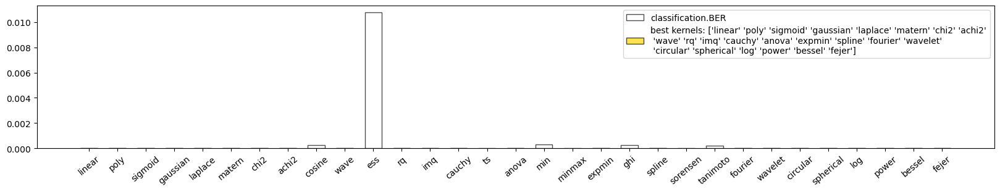

classification.BER
best kernels: ['linear' 'poly' 'sigmoid' 'gaussian' 'laplace' 'matern' 'chi2' 'achi2'
 'wave' 'rq' 'imq' 'cauchy' 'anova' 'expmin' 'spline' 'fourier' 'wavelet'
 'circular' 'spherical' 'log' 'power' 'bessel' 'fejer']
best value: 0.0


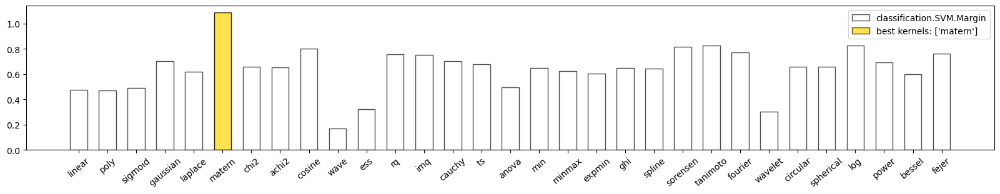

classification.SVM.Margin
best kernels: ['matern']
best value: 1.087983784037803


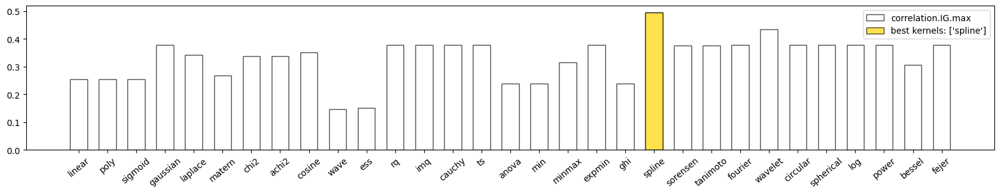

correlation.IG.max
best kernels: ['spline']
best value: 0.49521780256757886


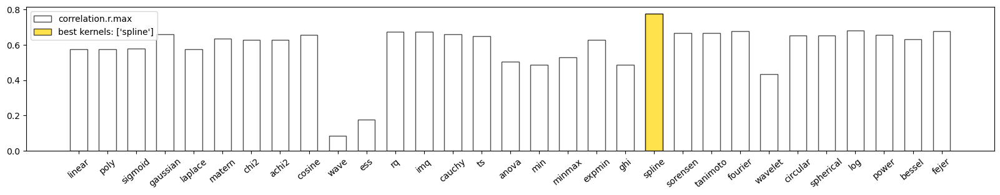

correlation.r.max
best kernels: ['spline']
best value: 0.7759422158890577


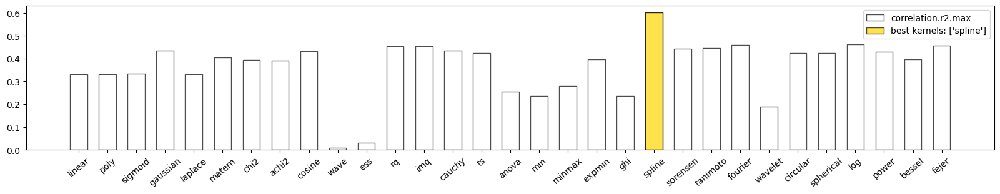

correlation.r2.max
best kernels: ['spline']
best value: 0.602086322398821


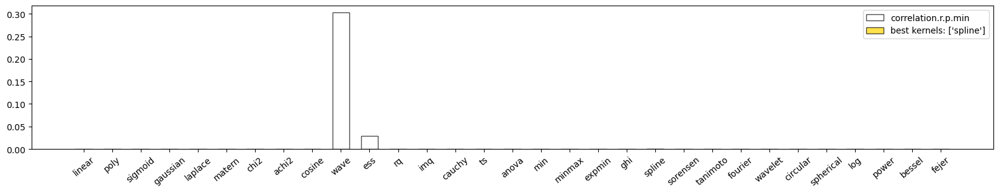

correlation.r.p.min
best kernels: ['spline']
best value: 5.059484459378843e-32


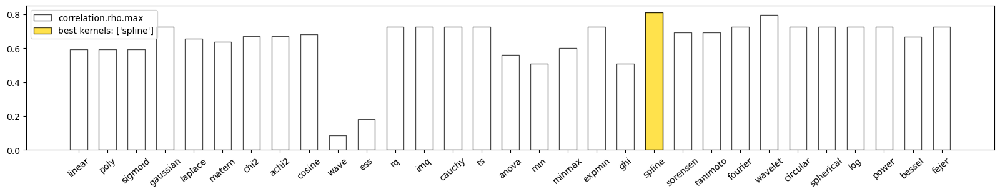

correlation.rho.max
best kernels: ['spline']
best value: 0.810797697883535


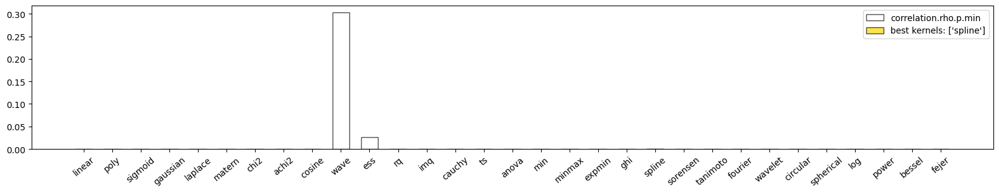

correlation.rho.p.min
best kernels: ['spline']
best value: 6.004507100472716e-37


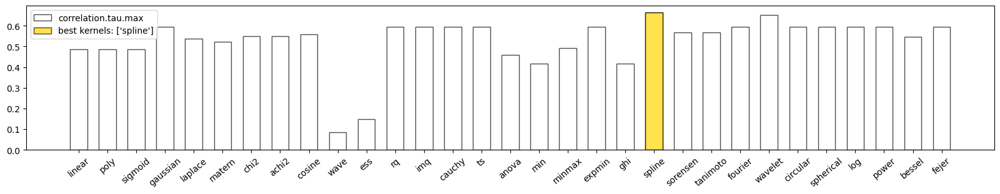

correlation.tau.max
best kernels: ['spline']
best value: 0.6641734675816798


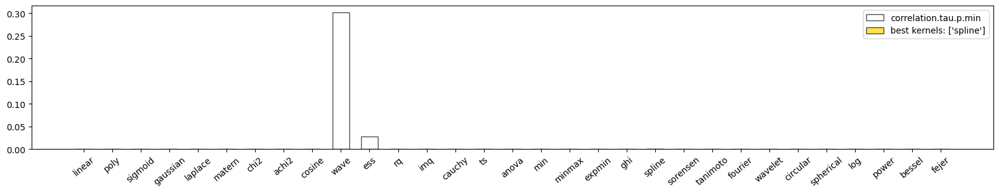

correlation.tau.p.min
best kernels: ['spline']
best value: 1.5838086806258822e-23


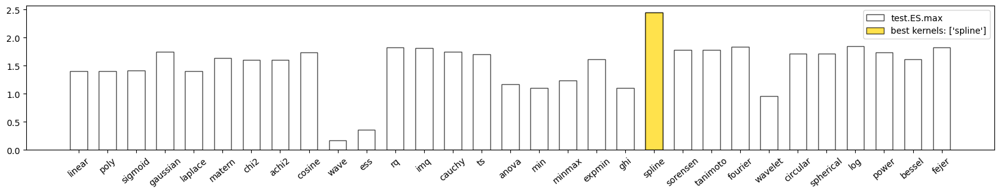

test.ES.max
best kernels: ['spline']
best value: 2.4453426945411048


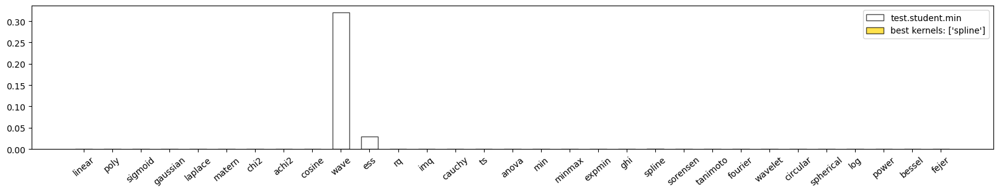

test.student.min
best kernels: ['spline']
best value: 4.364351157427831e-29


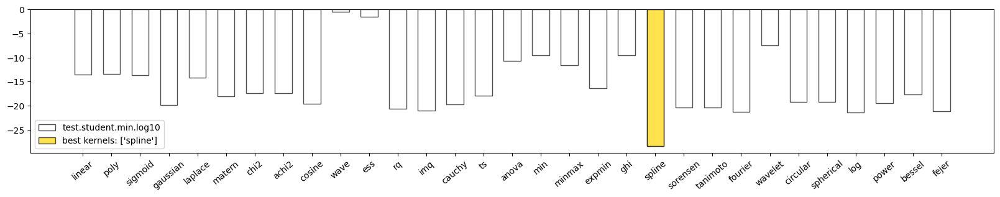

test.student.min.log10
best kernels: ['spline']
best value: -28.360080313171302


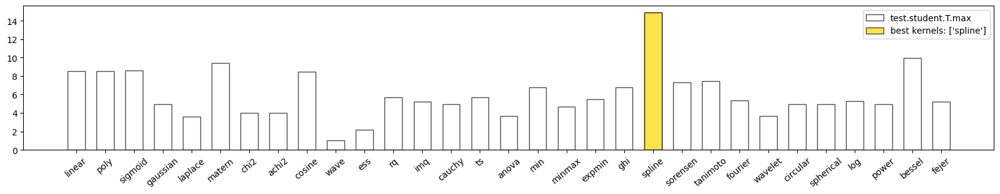

test.student.T.max
best kernels: ['spline']
best value: 14.895689238730068


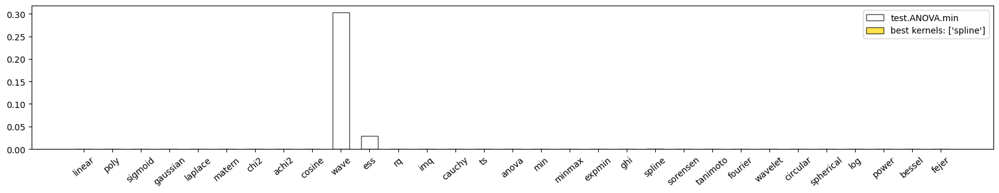

test.ANOVA.min
best kernels: ['spline']
best value: 5.059484459378652e-32


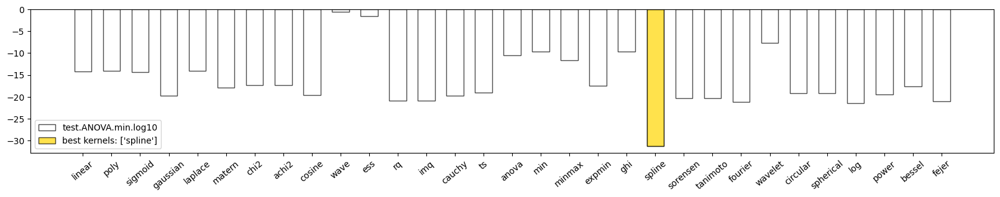

test.ANOVA.min.log10
best kernels: ['spline']
best value: -31.295893733724178


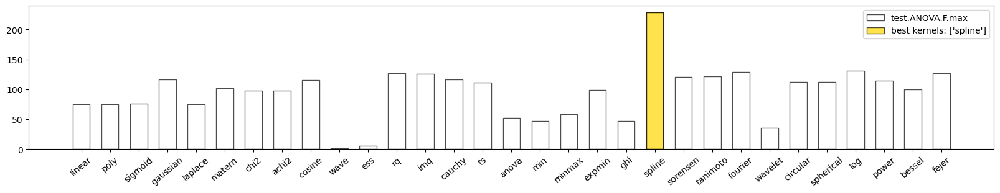

test.ANOVA.F.max
best kernels: ['spline']
best value: 228.47929035840875


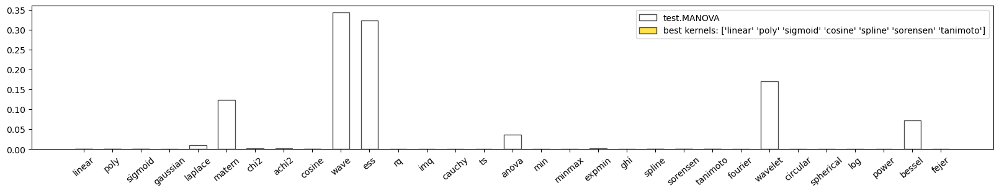

test.MANOVA
best kernels: ['linear' 'poly' 'sigmoid' 'cosine' 'spline' 'sorensen' 'tanimoto']
best value: 2.220446049250313e-16


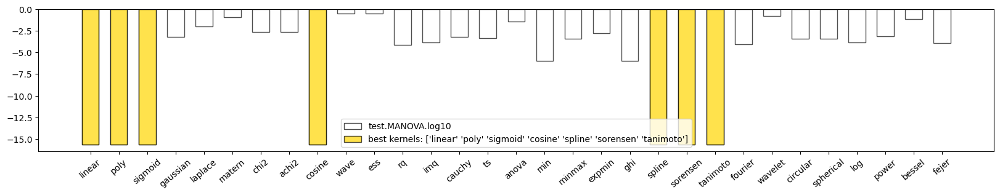

test.MANOVA.log10
best kernels: ['linear' 'poly' 'sigmoid' 'cosine' 'spline' 'sorensen' 'tanimoto']
best value: -15.653559774527022


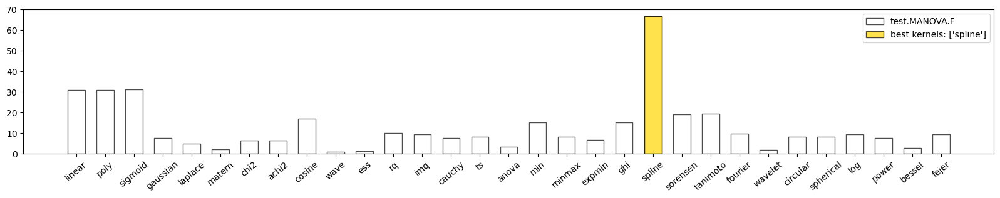

test.MANOVA.F
best kernels: ['spline']
best value: 66.712866


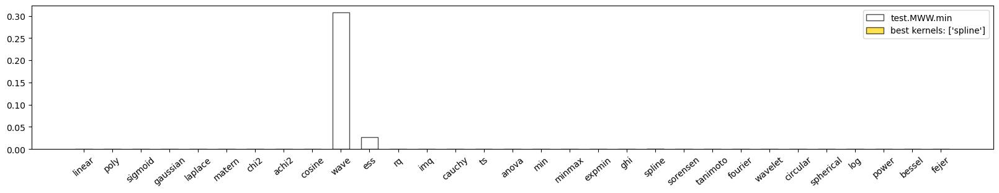

test.MWW.min
best kernels: ['spline']
best value: 1.6132609396769777e-23


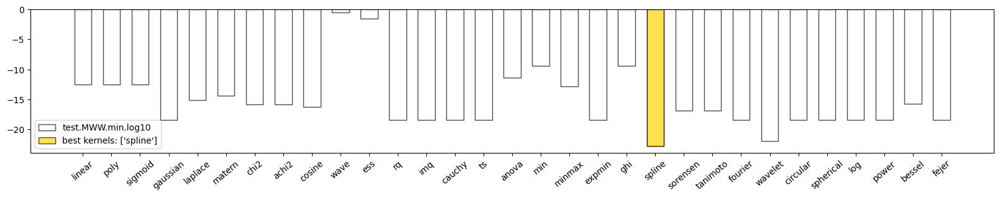

test.MWW.min.log10
best kernels: ['spline']
best value: -22.792295381218366


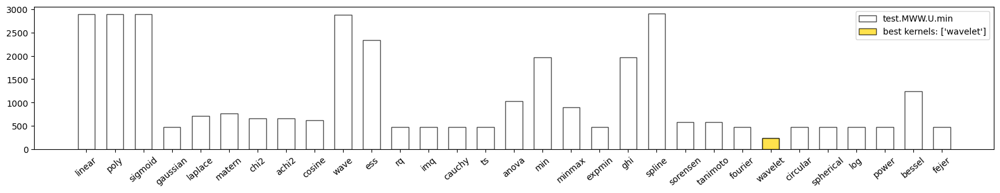

test.MWW.U.min
best kernels: ['wavelet']
best value: 239.0


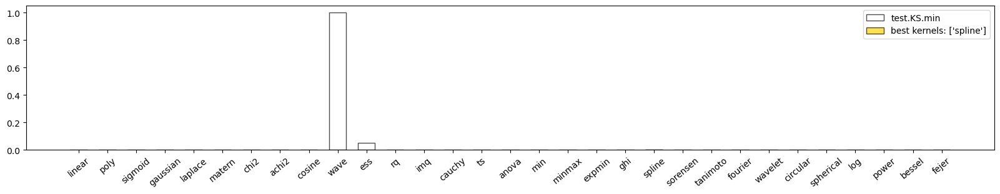

test.KS.min
best kernels: ['spline']
best value: 4.51718141233206e-31


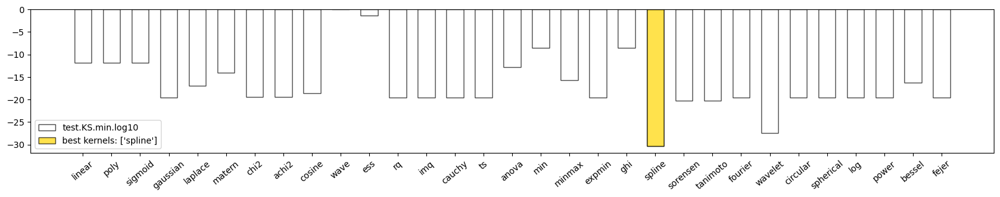

test.KS.min.log10
best kernels: ['spline']
best value: -30.345132467598294


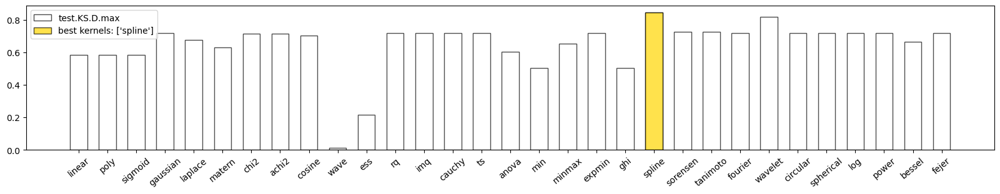

test.KS.D.max
best kernels: ['spline']
best value: 0.8446801231611358


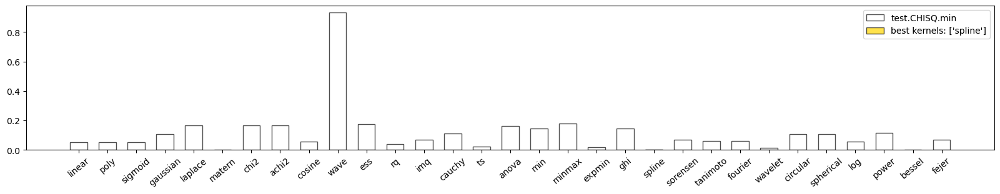

test.CHISQ.min
best kernels: ['spline']
best value: 8.068263095501574e-05


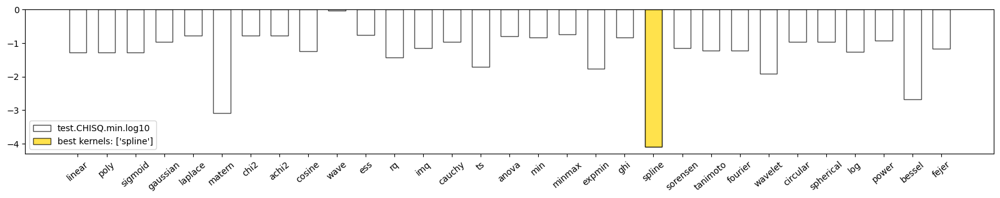

test.CHISQ.min.log10
best kernels: ['spline']
best value: -4.093219948453623


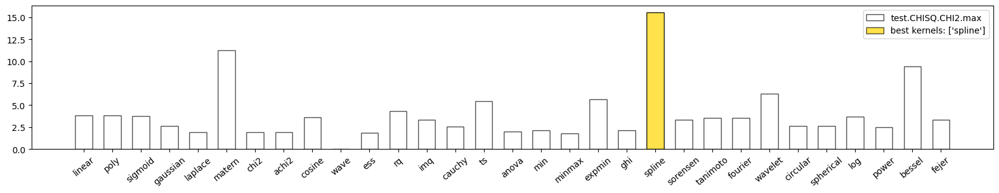

test.CHISQ.CHI2.max
best kernels: ['spline']
best value: 15.542228547908616


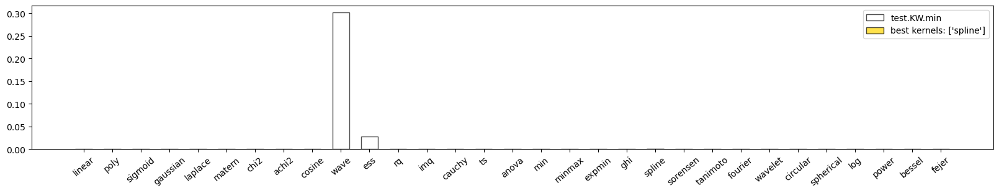

test.KW.min
best kernels: ['spline']
best value: 1.5838086806259175e-23


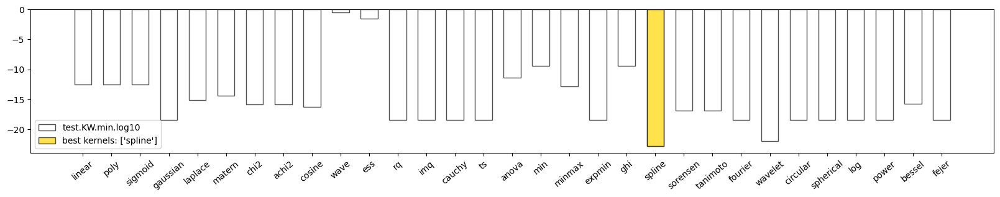

test.KW.min.log10
best kernels: ['spline']
best value: -22.800297281058832


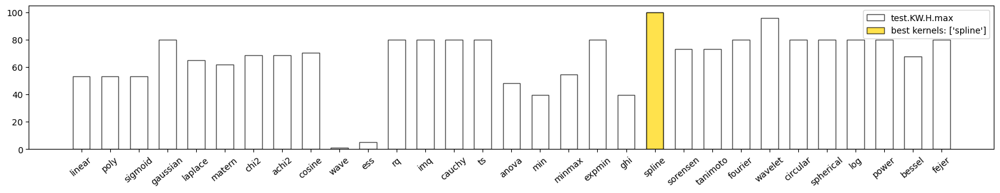

test.KW.H.max
best kernels: ['spline']
best value: 99.92372184777241


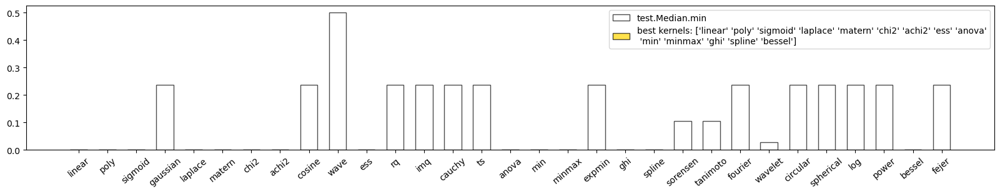

test.Median.min
best kernels: ['linear' 'poly' 'sigmoid' 'laplace' 'matern' 'chi2' 'achi2' 'ess' 'anova'
 'min' 'minmax' 'ghi' 'spline' 'bessel']
best value: 0.0


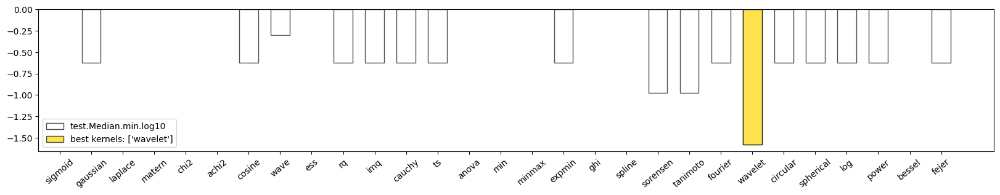

test.Median.min.log10
best kernels: ['wavelet']
best value: -1.5794827344766842


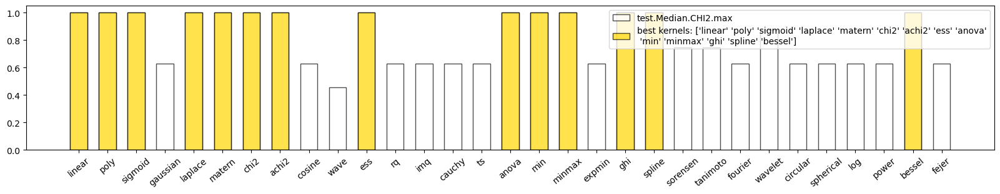

test.Median.CHI2.max
best kernels: ['linear' 'poly' 'sigmoid' 'laplace' 'matern' 'chi2' 'achi2' 'ess' 'anova'
 'min' 'minmax' 'ghi' 'spline' 'bessel']
best value: 1.0


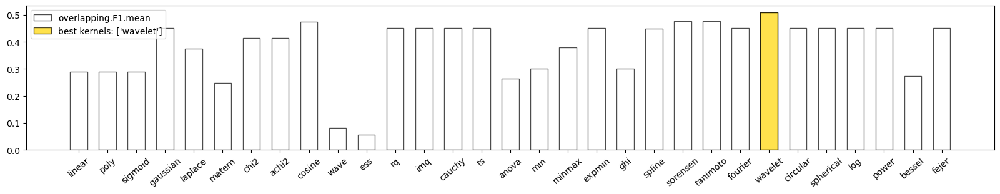

overlapping.F1.mean
best kernels: ['wavelet']
best value: 0.5090570993357588


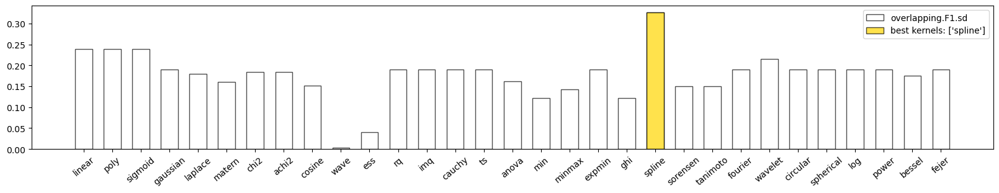

overlapping.F1.sd
best kernels: ['spline']
best value: 0.3263474235118522


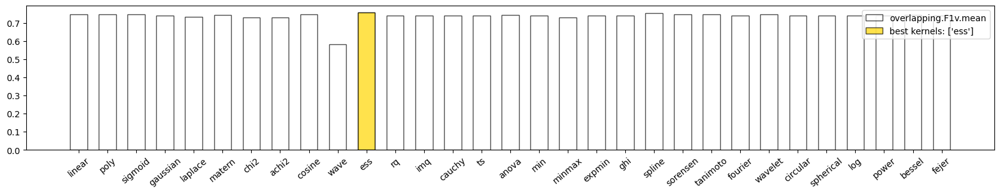

overlapping.F1v.mean
best kernels: ['ess']
best value: 0.7572301251655346


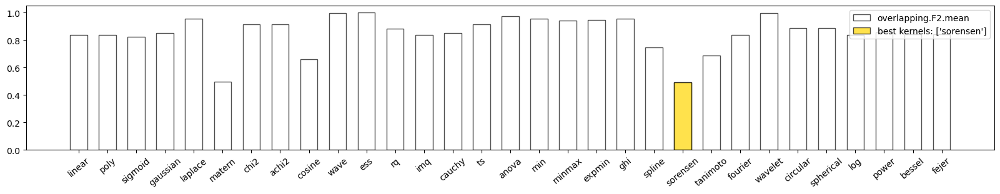

overlapping.F2.mean
best kernels: ['sorensen']
best value: 0.49019607843137253


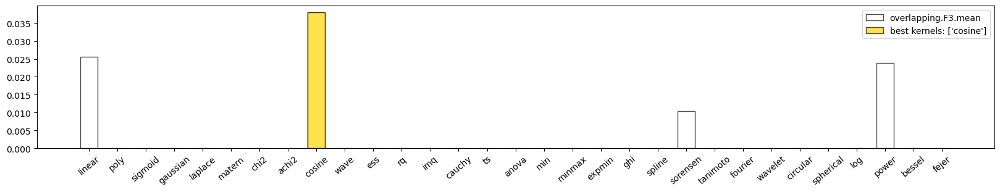

overlapping.F3.mean
best kernels: ['cosine']
best value: 0.03805178252489583
All-NaN slice encountered


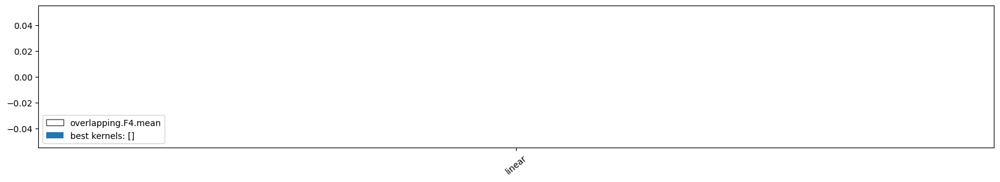

overlapping.F4.mean
best kernels: []
best value: None


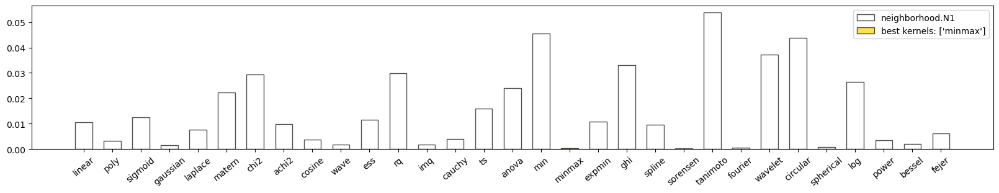

neighborhood.N1
best kernels: ['minmax']
best value: 0.00013772861639852973


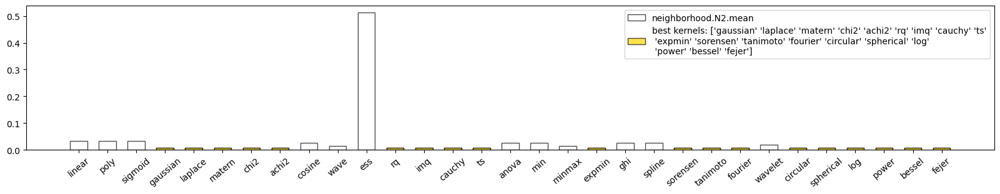

neighborhood.N2.mean
best kernels: ['gaussian' 'laplace' 'matern' 'chi2' 'achi2' 'rq' 'imq' 'cauchy' 'ts'
 'expmin' 'sorensen' 'tanimoto' 'fourier' 'circular' 'spherical' 'log'
 'power' 'bessel' 'fejer']
best value: 0.006578947368421052


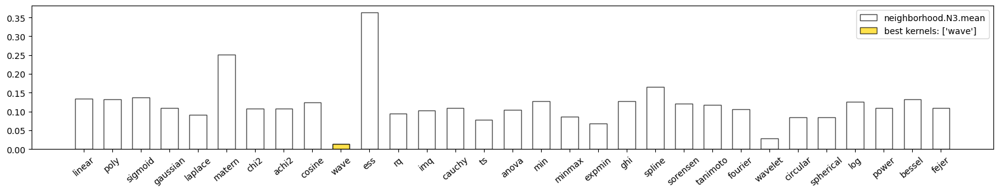

neighborhood.N3.mean
best kernels: ['wave']
best value: 0.013071895424836602


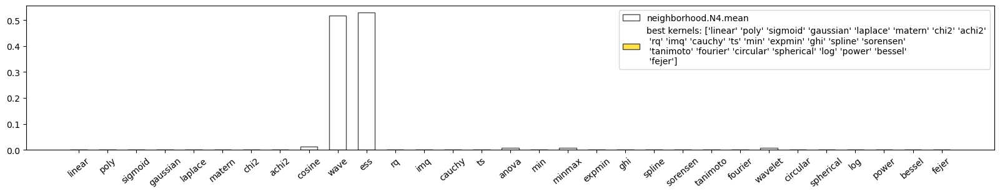

neighborhood.N4.mean
best kernels: ['linear' 'poly' 'sigmoid' 'gaussian' 'laplace' 'matern' 'chi2' 'achi2'
 'rq' 'imq' 'cauchy' 'ts' 'min' 'expmin' 'ghi' 'spline' 'sorensen'
 'tanimoto' 'fourier' 'circular' 'spherical' 'log' 'power' 'bessel'
 'fejer']
best value: 0.0


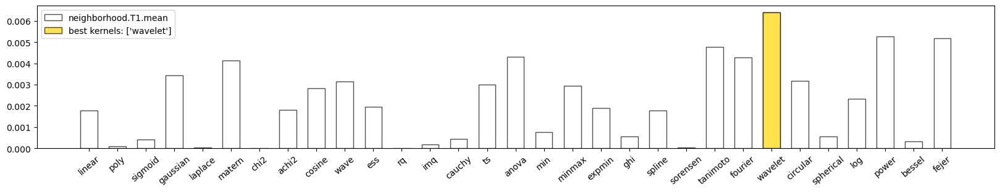

neighborhood.T1.mean
best kernels: ['wavelet']
best value: 0.006404580096384189


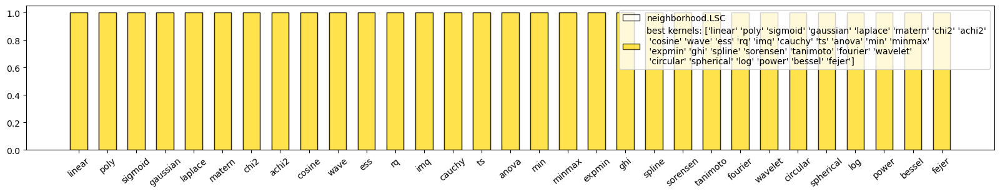

neighborhood.LSC
best kernels: ['linear' 'poly' 'sigmoid' 'gaussian' 'laplace' 'matern' 'chi2' 'achi2'
 'cosine' 'wave' 'ess' 'rq' 'imq' 'cauchy' 'ts' 'anova' 'min' 'minmax'
 'expmin' 'ghi' 'spline' 'sorensen' 'tanimoto' 'fourier' 'wavelet'
 'circular' 'spherical' 'log' 'power' 'bessel' 'fejer']
best value: 1.0


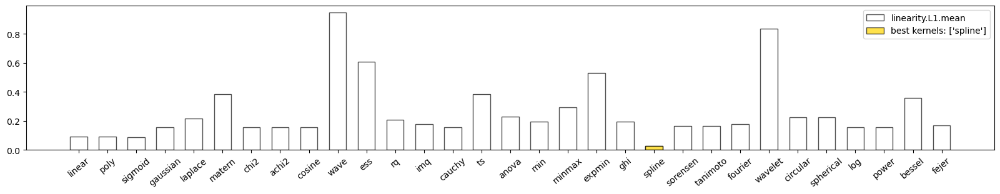

linearity.L1.mean
best kernels: ['spline']
best value: 0.026143790849673203


,linear,poly,sigmoid,gaussian,laplace,matern,chi2,achi2,cosine,wave,ess,rq,imq,cauchy,ts,anova,min,minmax,expmin,ghi,spline,sorensen,tanimoto,fourier,wavelet,circular,spherical,log,power,bessel,fejer,best kernel(s)
classification.ACC,1.0,1.0,1.0,1.0,1.0,0.948,0.993,1.0,1.0,0.516,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.516,0.516,1.0,1.0,1.0,1.0,['linear' 'poly' 'sigmoid' 'gaussian' 'laplace' 'achi2' 'cosine' 'ess' 'rq' 'imq' 'cauchy' 'ts' 'anova' 'min' 'minmax' 'expmin' 'ghi' 'spline' 'sorensen' 'tanimoto' 'fourier' 'wavelet' 'log' 'power' 'bessel' 'fejer']
classification.Kappa,1.0,1.0,1.0,1.0,1.0,0.896,0.987,1.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,1.0,1.0,1.0,['linear' 'poly' 'sigmoid' 'gaussian' 'laplace' 'achi2' 'cosine' 'ess' 'rq' 'imq' 'cauchy' 'ts' 'anova' 'min' 'minmax' 'expmin' 'ghi' 'spline' 'sorensen' 'tanimoto' 'fourier' 'wavelet' 'log' 'power' 'bessel' 'fejer']
classification.F1_Score,1.0,1.0,1.0,1.0,1.0,0.947,0.994,1.0,1.0,0.681,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.681,0.681,1.0,1.0,1.0,1.0,['linear' 'poly' 'sigmoid' 'gaussian' 'laplace' 'achi2' 'cosine' 'ess' 'rq' 'imq' 'cauchy' 'ts' 'anova' 'min' 'minmax' 'expmin' 'ghi' 'spline' 'sorensen' 'tanimoto' 'fourier' 'wavelet' 'log' 'power' 'bessel' 'fejer']
classification.Jaccard,1.0,1.0,1.0,1.0,1.0,0.899,0.987,1.0,1.0,0.516,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.516,0.516,1.0,1.0,1.0,1.0,['linear' 'poly' 'sigmoid' 'gaussian' 'laplace' 'achi2' 'cosine' 'ess' 'rq' 'imq' 'cauchy' 'ts' 'anova' 'min' 'minmax' 'expmin' 'ghi' 'spline' 'sorensen' 'tanimoto' 'fourier' 'wavelet' 'log' 'power' 'bessel' 'fejer']
classification.Precision,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.516,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.516,0.516,1.0,1.0,1.0,1.0,['linear' 'poly' 'sigmoid' 'gaussian' 'laplace' 'matern' 'chi2' 'achi2' 'cosine' 'ess' 'rq' 'imq' 'cauchy' 'ts' 'anova' 'min' 'minmax' 'expmin' 'ghi' 'spline' 'sorensen' 'tanimoto' 'fourier' 'wavelet' 'log' 'power' 'bessel' 'fejer']
classification.Recall,1.0,1.0,1.0,1.0,1.0,0.899,0.987,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,['linear' 'poly' 'sigmoid' 'gaussian' 'laplace' 'achi2' 'cosine' 'wave' 'ess' 'rq' 'imq' 'cauchy' 'ts' 'anova' 'min' 'minmax' 'expmin' 'ghi' 'spline' 'sorensen' 'tanimoto' 'fourier' 'wavelet' 'circular' 'spherical' 'log' 'power' 'bessel' 'fejer']
classification.McNemar,0.0,0.0,0.0,0.0,0.0,0.013,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,['chi2']
classification.McNemar.CHI2,inf,inf,inf,inf,inf,6.125,0.0,inf,inf,72.014,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,inf,72.014,72.014,inf,inf,inf,inf,['wave' 'circular' 'spherical']
classification.CochranQ,nan,nan,nan,nan,nan,0.005,0.317,nan,nan,0.0,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,0.0,0.0,nan,nan,nan,nan,['chi2']
classification.CochranQ.T,nan,nan,nan,nan,nan,8.0,1.0,nan,nan,74.0,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,74.0,74.0,nan,nan,nan,nan,['chi2']


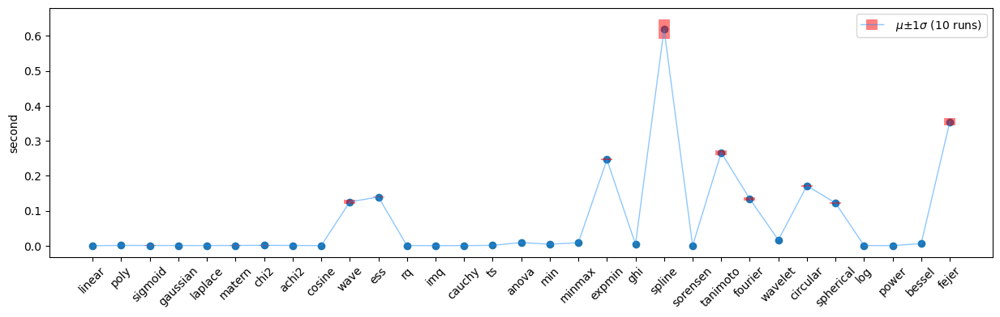

Averaged run time:  {'linear': 0.0005330399999820656, 'poly': 0.001255780000019513, 'sigmoid': 0.0010533899999700224, 'gaussian': 0.0008531599999969331, 'laplace': 0.0009588300000359596, 'matern': 0.0010622300000704854, 'chi2': 0.0015329599999404308, 'achi2': 0.0010734900000443303, 'cosine': 0.0006401799998911883, 'wave': 0.12564828000004127, 'ess': 0.1396172900000238, 'rq': 0.0008643500000744097, 'imq': 0.0007197100000666979, 'cauchy': 0.0007055700000364595, 'ts': 0.0013940000000729925, 'anova': 0.009526310000001103, 'min': 0.00457687000007354, 'minmax': 0.009137409999948432, 'expmin': 0.24609885000008944, 'ghi': 0.0048651699999936685, 'spline': 0.619002909999972, 'sorensen': 0.0005958000000646279, 'tanimoto': 0.2664417499999672, 'fourier': 0.13406980999989174, 'wavelet': 0.016821520000030434, 'circular': 0.17183224000000336, 'spherical': 0.12226695000003929, 'log': 0.0008870499998920422, 'power': 0.0006978700000217942, 'bessel': 0.006462650000094073, 'fejer': 0.3537622499999998}


In [6]:
analyze_dataset('vintage')

</br></br><hr/></br></br>

# Appendix

## linear kernel. 

Some algorithms with a preceding linear kernel equal to their non-kernel counterparts, e.g., linear-kernel-PCA is the same as vanilla PCA.

Verify linear-kernel-PCA equals vanilla PCA

load dataset from 7545.csv
X.shape (120, 600)  y.shape (120,)


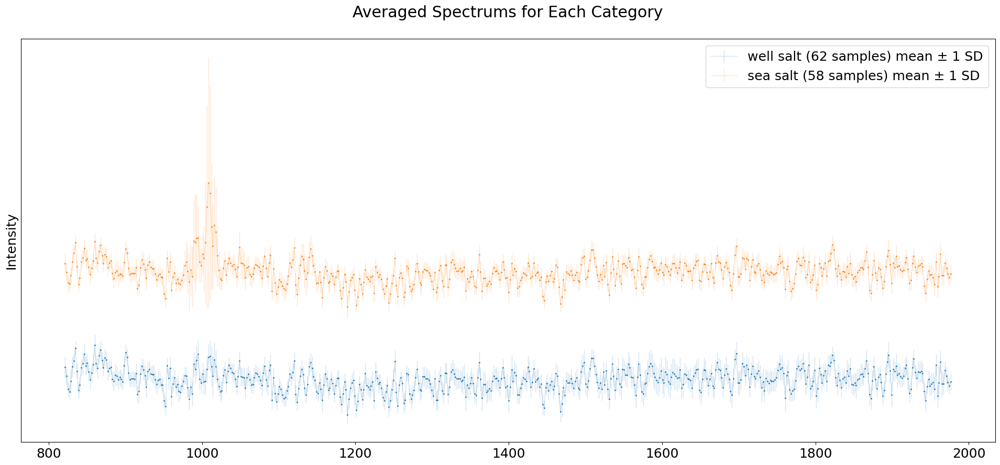

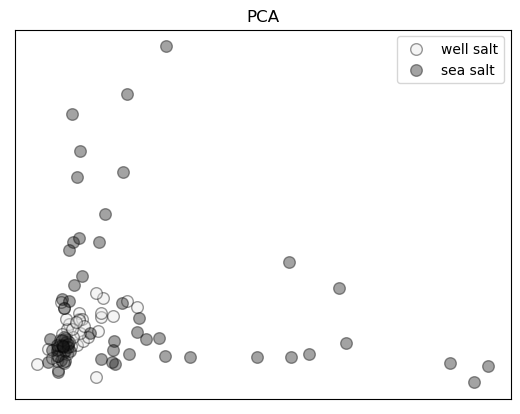

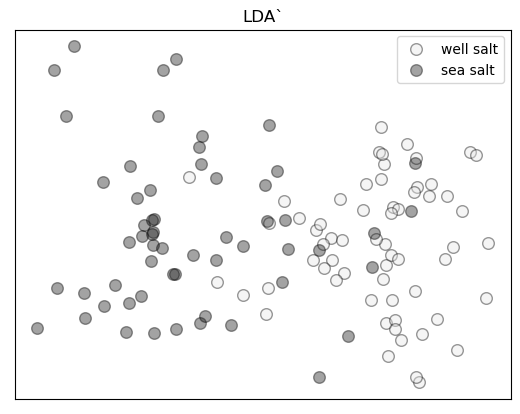

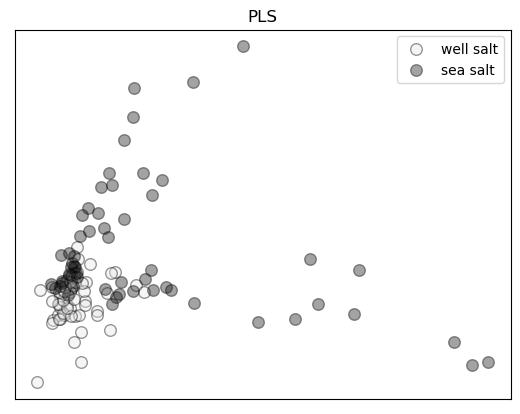

食盐拉曼光谱

C1 - "shenjinkuangyan(zhongyan)：深井矿盐（中盐集团）加碘盐", 
“deep well mineral salt” from CNSIC (China National Salt Industry Co.,Ltd).

C2 - "aozhoutianranhaiyan(huaiyan)：澳洲天然海盐（淮盐）未加碘",
“Australian natural sea salt” from Suyan Group.

DXR2xi显微拉曼成像光谱仪（美国Thermo Fisher公司），
配备有532 nm激光器。
仪器参数设置：
激光功率为10 mw，曝光时间1 s，扫描次数500，
拉曼位移范围为100～3000 cm-1。


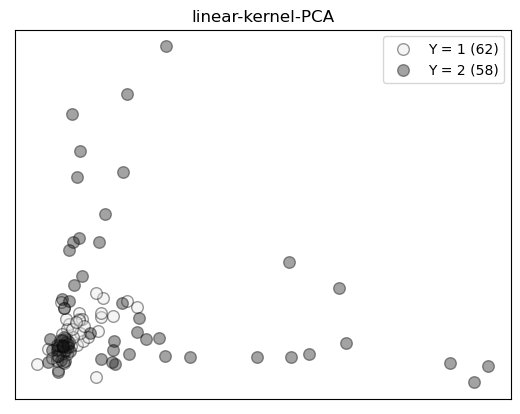

In [7]:
from sklearn.decomposition import KernelPCA
import matplotlib.pyplot as plt
from qsi.vis import plotComponents2D

X, y, X_names, desc, labels = io.load_dataset('salt', x_range = list(range(400,1000)), shift = 200, display=True)

transformer = KernelPCA(n_components=2, kernel='linear')
X_kpca = transformer.fit_transform(X)
# plt.scatter(X_kpca[:,0], X_kpca[:,1]
plotComponents2D(X_kpca, y)
plt.title('linear-kernel-PCA')
plt.show()

It's identical to the PCA plot.

## Wave kernel

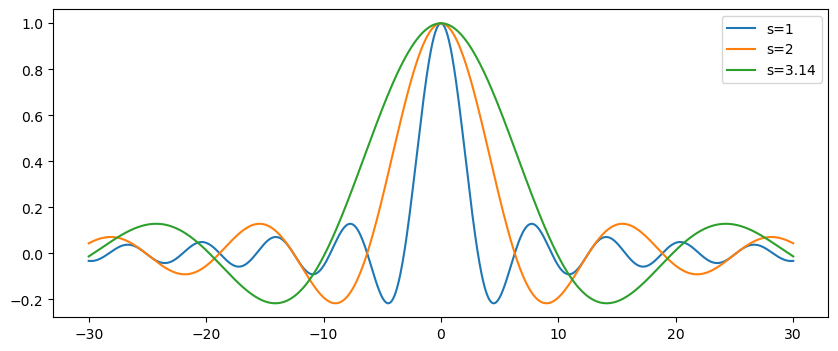

In [8]:
import matplotlib.pyplot as plt
import numpy as np
plt.figure(figsize = (10,4))

for s in [1, 2, 3.14]:

    x = np.linspace(-30,30,1000) #np.linspace(-1/q,1/q,100)
    Y = s/x * np.sin(x/s)
    plt.plot(x,Y,label = 's='+str(s))
    
plt.legend()

## Draw the inner function of Fourier kerenl

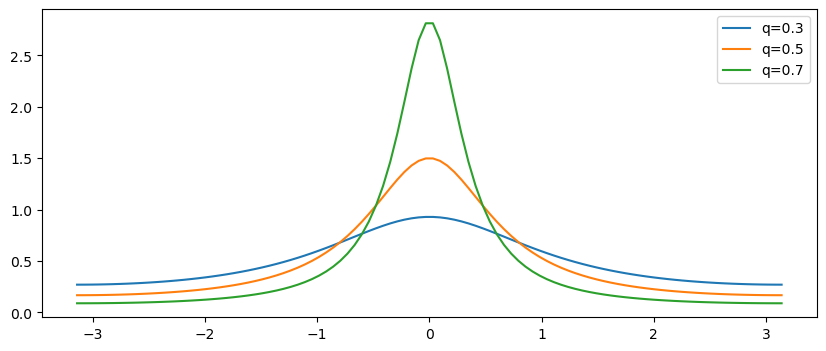

In [9]:
q = 0.5

plt.figure(figsize = (10,4))

for q in [0.3, 0.5, 0.7]:

    x = np.linspace(-3.14,3.14,100) #np.linspace(-1/q,1/q,100)
    H = (1- q ** 2) / (2.*(1. - 2.*q * np.cos(x) + q ** 2))
    plt.plot(x,H,label = 'q='+str(q))
    
plt.legend()

## Draw the spherical kernel against the pair-wise distance.

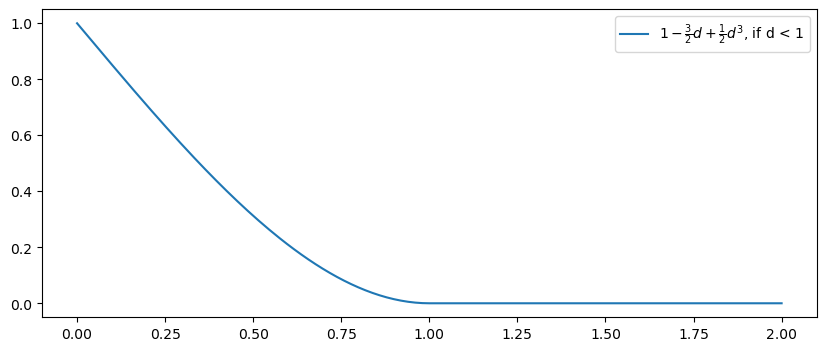

In [10]:
plt.figure(figsize = (10,4))

x = np.linspace(0,1,100) #np.linspace(-1/q,1/q,100)
x2 = list(np.linspace(1,2,100))
Y = list(1 - 3/2*x + 1/2*(x)**3)
Y2 = [0]*100
plt.plot(list(x)+x2,Y+Y2, label = r'$1 - \frac{3}{2}{d} + \frac{1}{2} { d }^3$, if d < 1') 
plt.legend()

## Circular kernel

$k(x, y) = \frac{2}{\pi} \arccos ( \frac{ \lVert x-y \rVert}{\sigma}) - \frac{2}{\pi} \frac{ \lVert x-y \rVert}{\sigma} \sqrt{1 - {\left( \frac{ \lVert x-y \rVert}{\sigma} \right)}^2 } $

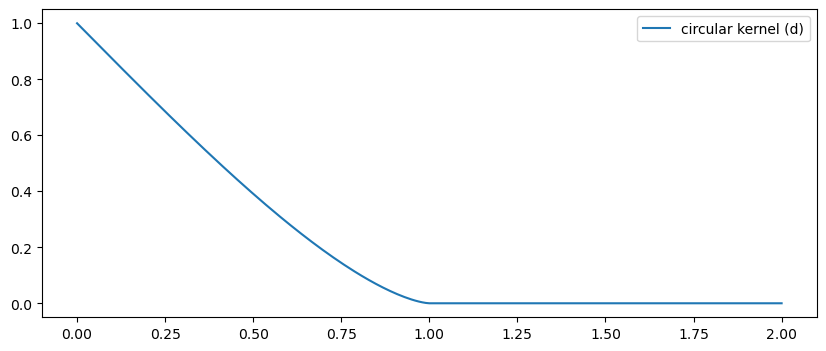

In [11]:
import math
plt.figure(figsize = (10,4))

x = np.linspace(0,1,100) #np.linspace(-1/q,1/q,100)
x2 = list(np.linspace(1,2,100))
Y = list( - 2/math.pi * x * np.sqrt(1-x**2) + 2 /math.pi * np.arccos(x)  )
Y2 = [0]*100
plt.plot(list(x)+x2,Y+Y2, label = 'circular kernel (d)') 
plt.legend()

## Draw the Fejér kernel curves against the pair-wise distance d at different n values.

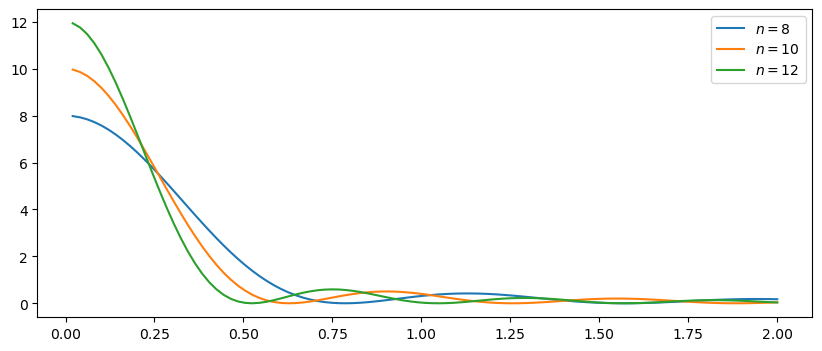

In [12]:
plt.figure(figsize = (10,4))

for n in [8, 10, 12]:
    x = np.linspace(0,2, 100) # np.linspace(-1/q,1/q,100)
    Y = (1- np.cos(n*x) ) / ( 1 - np.cos(x)) / n
    plt.plot(x, Y, label = '$n = ' + str(n)+'$') 
plt.legend()

<br/><br/><br/><br/><br/><br/><br/><br/><br/><br/><br/><br/><br/><br/><br/><br/><hr/>

We will not implement the following kernels.

### Bayesian Kernel (需要一个目标变量Y参与运算)

The Bayesian kernel could be given as:

$ k(x,y) = \prod_{l=1}^N \kappa_l (x_l,y_l) $

where

$ \kappa_l(a,b) = \sum_{c \in \{0;1\}} P(Y=c \mid X_l=a) ~ P(Y=c \mid X_l=b) $

However, it really depends on the problem being modeled. For more information, please see the work by Alashwal, Deris and Othman, in which they used a SVM with Bayesian kernels in the prediction of protein-protein interactions.


### B-Spline Kernel

The B-Spline kernel is defined on the interval [−1, 1]. It is given by the recursive formula:

$ k(x,y) = B_{2p+1}(x-y) $

$ \mbox{where~} p \in N \mbox{~with~} B_{i+1} := B_i \otimes B_0. $

In the work by Bart Hamers it is given by: $ k(x, y) = \prod_{p=1}^d B_{2n+1}(x_p - y_p) $

Alternatively, Bn can be computed using the explicit expression (Fomel, 2000):

$ B_n(x) = \frac{1}{n!} \sum_{k=0}^{n+1} \binom{n+1}{k} (-1)^k (x + \frac{n+1}{2} - k)^n_+ $

Where x+ is defined as the truncated power function:

$ x^d_+ = \begin{cases} x^d, & \mbox{if }x > 0 \\ 0, & \mbox{otherwise} \end{cases} $
